# Финальный проект

## Прогнозирование стоимости дома по характеристикам
План проекта
- 1. Постановка задачи
- 2. Выбор метрики
- 3. Импорт используемых модулей
- 4. Пользовательские функции
- 5. EDA
- 6. Промежуточные итоги
- 7. Выбор значимых признаков
- 8. Наивная модель
- 9. CatBoost
- 10. RandomForestRegressor
- 11. GradientBoostingRegressor
- 12. Простая полносвязная нейросеть
- 13. Blending
- 14. Выводы

### 1. Постановка задачи
Необходимо создать модели прогнозирования стоимости объекта недвижимости по заданным характеристикам и определить наиболее точную модель по метрике качества
Для обучения моделей будет использован датасет https://drive.google.com/file/d/1An8LtTSdv6pB5nSpNBwH1Njcwh2SpYW6/view

Сложность заключается в том, что представленный датасет не имеет описания. Поэтому значительная часть времени уйдет на анализ данных датасета.

### 2. Выбор метрики
Для определения качества модели будем использовать метрику MAPE. Эта метрика показывает, на сколько процентов в среднем наше предсказание отклоняется от реального значения. 

### 3. Импорт используемых модулей

In [1]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import json
import random
import numpy as np  # linear algebra
import pandas as pd  # data processing, CSV file I/O (e.g. pd.read_csv)
import os
import sys
import PIL
# import cv2
import re
import seaborn as sns
from itertools import combinations
from scipy.stats import ttest_ind
from uszipcode import SearchEngine
from sklearn.feature_extraction import FeatureHasher
# import pymorphy2

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

from catboost import CatBoostRegressor
from sklearn.ensemble import GradientBoostingRegressor, ExtraTreesRegressor, RandomForestRegressor
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler

# # keras
import tensorflow as tf
import tensorflow.keras.layers as L
from tensorflow.keras.models import Model, Sequential
from tensorflow.keras.preprocessing.text import Tokenizer
from tensorflow.keras.preprocessing import sequence
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping
from tensorflow.keras import regularizers
# import albumentations

# Imports from our package
# from lightautoml.automl.presets.tabular_presets import TabularAutoML, TabularUtilizedAutoML
# from lightautoml.tasks import Task

# plt
import matplotlib.pyplot as plt
# увеличим дефолтный размер графиков
from pylab import rcParams
rcParams['figure.figsize'] = 10, 5
# графики в svg выглядят более четкими
%config InlineBackend.figure_format = 'svg'
%matplotlib inline

In [2]:
print('Python       :', sys.version.split('\n')[0])
print('Numpy        :', np.__version__)
print('Tensorflow   :', tf.__version__)

Python       : 3.8.6 (tags/v3.8.6:db45529, Sep 23 2020, 15:52:53) [MSC v.1927 64 bit (AMD64)]
Numpy        : 1.19.3
Tensorflow   : 2.4.1


In [3]:
# зафиксируем RANDOM_SEED, чтобы наши эксперименты были воспроизводимы!
RANDOM_SEED = 42
np.random.seed(RANDOM_SEED)

### 4. Пользовательские функции

In [4]:
def show_hist(df, col_name, bins=10):
    """Построение гистограммы по столбцу"""
    color_text = plt.get_cmap('PuBu')(0.95)
    plt.style.use('bmh')
    plt.rcParams['figure.figsize'] = (6, 2)
    _, axes = plt.subplots(1, 1)
    axes.hist(df, bins=bins)
    axes.set_title("Гистограмма и boxplot для признака '" +
                   col_name+"'", color=color_text, fontsize=14)
    return


def show_plot_boxplot(df, col_name, bins=10):
    """Построение гистограммы по столбцу и boxplot-а"""
    color_text = plt.get_cmap('PuBu')(0.95)
    plt.style.use('bmh')
    plt.rcParams['figure.figsize'] = (10, 5)
    _, axes = plt.subplots(2, 1)
    axes[0].hist(df, bins=bins)
    axes[0].set_title("Гистограмма и boxplot для признака '" +
                      col_name+"'", color=color_text, fontsize=14)
    axes[1].boxplot(df, vert=False, showmeans=True)
    axes[1].set_title('')
    return

In [5]:
# Функция отрисовки BOXPLOT
def get_boxplot(column):
    fig, ax = plt.subplots(figsize=(12, 6))
    sns.boxplot(x=column,
                y='target',
                data=df.loc[
                    df.loc[:, column].isin(
                        df.loc[:, column].value_counts().index)
                ],
                ax=ax)
    plt.xticks(rotation=90)
    ax.set_title('Boxplot для ' + column)
    plt.show()

# Функция теста Стьюдента для статистически значимых признаков


def get_stat_dif(column):
    cols = df.loc[:, column].value_counts().index[:10]
    combinations_all = list(combinations(cols, 2))
    for comb in combinations_all:
        if ttest_ind(df.loc[df.loc[:, column] == comb[0], 'target'],
                     df.loc[df.loc[:, column] == comb[1], 'target']).pvalue \
                <= 0.05/len(combinations_all):
            print('Статистически значимые различия были обнаружены для столбца', column)
            break

In [6]:
# функция ошибки
def mape(y_true, y_pred):
    return np.mean(np.abs((y_pred-y_true)/y_true))

In [7]:
def describe_collumns(df):
    list_of_names = list(df.columns)
    temp_dict = {}
    temp_dict['имя признака'] = list_of_names
    temp_dict['тип'] = df.dtypes
    temp_dict['# пропусков(NaN)'] = df.isnull().sum().values
    temp_dict['# уникальных'] = df.nunique().values

    temp_df = pd.DataFrame.from_dict(temp_dict, orient='index')
    display(temp_df.T)

    return

In [8]:
DATA_DIR = './data/'
# train = pd.read_csv(DATA_DIR + 'train.csv')
# test = pd.read_csv(DATA_DIR + 'test.csv')
data = pd.read_csv(DATA_DIR + 'data.csv')

### 5. EDA

In [9]:
# посмотрим на признаки в данных
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 377185 entries, 0 to 377184
Data columns (total 18 columns):
 #   Column        Non-Null Count   Dtype 
---  ------        --------------   ----- 
 0   status        337267 non-null  object
 1   private pool  4181 non-null    object
 2   propertyType  342452 non-null  object
 3   street        377183 non-null  object
 4   baths         270847 non-null  object
 5   homeFacts     377185 non-null  object
 6   fireplace     103115 non-null  object
 7   city          377151 non-null  object
 8   schools       377185 non-null  object
 9   sqft          336608 non-null  object
 10  zipcode       377185 non-null  object
 11  beds          285903 non-null  object
 12  state         377185 non-null  object
 13  stories       226470 non-null  object
 14  mls-id        24942 non-null   object
 15  PrivatePool   40311 non-null   object
 16  MlsId         310305 non-null  object
 17  target        374704 non-null  object
dtypes: object(18)
memory usa

In [10]:
# постмотрим на данные
data.head(3)

,status,private pool,propertyType,street,baths,homeFacts,fireplace,city,schools,sqft,zipcode,beds,state,stories,mls-id,PrivatePool,MlsId,target
0,Active,NaN,Single Family Home,240 Heather Ln,3.5,"{'atAGlanceFacts': [{'factValue': '2019', 'fac...",Gas Logs,Southern Pines,"[{'rating': ['4', '4', '7', 'NR', '4', '7', 'N...",2900,28387,4,NC,NaN,NaN,NaN,611019,"$418,000"
1,for sale,NaN,single-family home,12911 E Heroy Ave,3 Baths,"{'atAGlanceFacts': [{'factValue': '2019', 'fac...",NaN,Spokane Valley,"[{'rating': ['4/10', 'None/10', '4/10'], 'data...","1,947 sqft",99216,3 Beds,WA,2.0,NaN,NaN,201916904,"$310,000"
2,for sale,NaN,single-family home,2005 Westridge Rd,2 Baths,"{'atAGlanceFacts': [{'factValue': '1961', 'fac...",yes,Los Angeles,"[{'rating': ['8/10', '4/10', '8/10'], 'data': ...","3,000 sqft",90049,3 Beds,CA,1.0,NaN,yes,FR19221027,"$2,895,000"


Всего строк 377185

In [11]:
describe_collumns(data)

,имя признака,тип,# пропусков(NaN),# уникальных
0,status,object,39918,159
1,private pool,object,373004,1
2,propertyType,object,34733,1280
3,street,object,2,337076
4,baths,object,106338,229
5,homeFacts,object,0,321009
6,fireplace,object,274070,1653
7,city,object,34,2026
8,schools,object,0,297365
9,sqft,object,40577,25405


У признаков schools, zipcode, state нет пропущенных значений. Признаки private pool, mls-id, PrivatePool, fireplace, stories, baths имеется максимальное количество пропусков

## 5.1. target

In [12]:
data.target

0           $418,000
1           $310,000
2         $2,895,000
3         $2,395,000
4             $5,000
             ...    
377180    $1,249,000
377181      $674,999
377182      $528,000
377183       $34,500
377184      $204,900
Name: target, Length: 377185, dtype: object

Целевая переменная - "стоимость".

In [13]:
# Посмотрим на данные, у которых два варианта цены
data[data.target.str.contains('-', na=False)]

,status,private pool,propertyType,street,baths,homeFacts,fireplace,city,schools,sqft,zipcode,beds,state,stories,mls-id,PrivatePool,MlsId,target
330468,for rent,NaN,apartment,The Collette Apartments in Dallas,1-2 Baths,"{'atAGlanceFacts': [{'factValue': '1964', 'fac...",NaN,Dallas,"[{'rating': ['5/10', '5/10', '5/10'], 'data': ...",610-840 sqft,75206,1-2 Beds,TX,NaN,NaN,NaN,NaN,"$1,215 - $1,437/mo"


Удалим эти значения

In [14]:
data.drop(data[data.target.str.contains('-', na=False)].index, inplace=True)
data.reset_index(drop=True, inplace=True)

Преобразуем признак в числовое значение:

<AxesSubplot:>

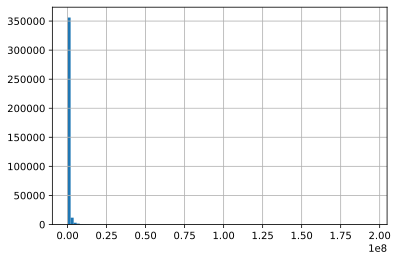

In [15]:
target = data.target
target = target.str.replace(r'\D+', '', regex=True)
target = pd.to_numeric(target)
data.target = target
# Посмотрим на распределение признака
data.target.hist(bins=100)

Цена распределена неравномерно. Посмотрим на значения свыше 10000000

<AxesSubplot:>

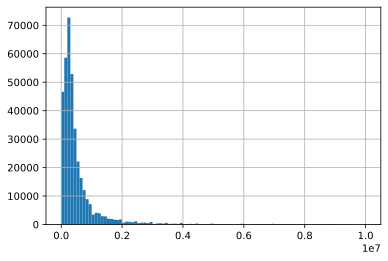

In [16]:
data.loc[data.target < 10000000, 'target'].hist(bins=100)

In [17]:
# Проверим количество записей со значением target более 3000000
len(data.loc[data['target'] > 3000000])

9722

In [18]:
# На весь датасет это менее 1%. Удалим записей со значением target более 3000000
data.drop(data.loc[data['target'] > 3000000].index, inplace=True)

In [19]:
# Проверим пропуски
data.target.isnull().sum()

2481

In [20]:
# Удалим записи с пропусками
data.dropna(subset=['target'], inplace=True)
data.reset_index(drop=True, inplace=True)

## 5.2. status

In [21]:
data.status.value_counts()

for sale                     152059
Active                       102086
For sale                      42105
foreclosure                    5667
New construction               5314
                              ...  
Contingent - Sale of Home         1
Conditional Contract              1
Reactivated                       1
Coming soon: Dec 27.              1
Backup                            1
Name: status, Length: 156, dtype: int64

Признак - статус жилья. Например 'for sale' - продается, 'active' - активно используется. Всего вариантов - 159. Большое количество вариантов скорее всего говорит о слиянии разных датасетов. Преобразуем все возможные варианты к основным вариантам: 
- 1) 'for sale' - на продажу;
- 2) 'active' - активно используется;
- 3) 'unknown' - значение пропущено или непонятно; 
- 4) 'new' - новое жилье;
- 5) 'for rent' - сдается в аренду

In [22]:
# приведем значения к нижнему регистру
status = data.status.str.lower().copy()

# Заменим пропущенные и непонятные значения на 'unknown'
status = status.fillna('unknown')
status[status == 'p'] = 'unknown'
status[status == 'c'] = 'unknown'
status[status == 'pi'] = 'unknown'
status[status == 'ct'] = 'unknown'
status[status == 'pf'] = 'unknown'
status[status == 'ps'] = 'unknown'

# Создадим словарь для замен
repl_dct = {'for sale': 'for sale', 'active': 'active', 'foreclosure': 'for sale', 'pending': 'for sale', 'for rent': 'for rent',
            'auction': 'for sale', 'under contract': 'for sale', 'contingent': 'for sale', 'contract': 'for sale', 'sold': 'active',
            'coming': 'for sale', 'closed': 'for sale', 'foreclosed': 'for sale', 'new construction': 'new',
            'recently sold': 'active', 'price change': 'for sale', 'back': 'for sale', 'continue show': 'for sale',
            'listing extended': 'for sale', 'accepted offer': 'for sale', 'due diligence period': 'for sale',
            'contingency': 'for sale', 'accepting backups': 'for sale', 'activated': 'for sale',
            'uc continue to show': 'for sale', 'lease/purchase': 'for sale'}

# Для каждого значения словаря делаем замену в поле status
for repl in repl_dct:
    for_repl = repl
    to_repl = repl_dct[for_repl]
    status[status.str.contains(for_repl, na=False)] = to_repl
data.status = status

# Проверяем, что получилось
data.status.value_counts()

for sale    215292
active      103414
unknown      39865
new           5999
for rent       411
Name: status, dtype: int64

In [23]:
# посмотрим записи с величиной target менее 10000, со значением status не равным 'for rent'
data.loc[(data['status'] != 'for rent') &
         (data['target'] < 10000)]

,status,private pool,propertyType,street,baths,homeFacts,fireplace,city,schools,sqft,zipcode,beds,state,stories,mls-id,PrivatePool,MlsId,target
4,for sale,NaN,lot/land,1524 Kiscoe St,NaN,"{'atAGlanceFacts': [{'factValue': '', 'factLab...",NaN,Palm Bay,"[{'rating': ['4/10', '5/10', '5/10'], 'data': ...",NaN,32908,NaN,FL,NaN,NaN,NaN,861745,5000.0
202,for sale,NaN,lot/land,3121 69th St W,NaN,"{'atAGlanceFacts': [{'factValue': '', 'factLab...",NaN,Lehigh Acres,"[{'rating': ['4/10', '2/10', '3/10', '2/10', '...",NaN,33971,NaN,FL,NaN,NaN,NaN,218057667,7000.0
244,for sale,NaN,lot/land,242 Narthex Ave S,NaN,"{'atAGlanceFacts': [{'factValue': '', 'factLab...",NaN,Lehigh Acres,"[{'rating': ['2/10', '2/10', '4/10', '2/10', '...",NaN,33974,NaN,FL,NaN,NaN,NaN,219024568,7500.0
374,for sale,NaN,lot/land,4385 Wakeman Dr,NaN,"{'atAGlanceFacts': [{'factValue': '', 'factLab...",NaN,Winston Salem,"[{'rating': ['3/10', '2/10', '3/10'], 'data': ...",NaN,27105,NaN,NC,NaN,NaN,NaN,931781,7000.0
720,active,NaN,Land,Fisher Rd,NaN,"{'atAGlanceFacts': [{'factValue': '', 'factLab...",NaN,Ocklawaha,"[{'rating': ['3', '3', '4', '2', '5', '4'], 'd...",0,32179,NaN,FL,NaN,NaN,NaN,553433,7000.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
364802,active,NaN,Land,14057 Nevada Ave,0,"{'atAGlanceFacts': [{'factValue': '', 'factLab...",NaN,Port Charlotte,"[{'rating': ['5', '4', '6', '5', 'NR', 'NR', '...",0,33953,NaN,FL,NaN,NaN,NaN,D6109075,5400.0
364839,active,NaN,Land,27217 Las Lomas Dr,0,"{'atAGlanceFacts': [{'factValue': '', 'factLab...",NaN,Punta Gorda,"[{'rating': ['6', '5', '7', '7', '2', '10'], '...",0,33955,NaN,FL,NaN,NaN,NaN,D6101598,5000.0
364895,for sale,NaN,Land,1057 Northview St,0,"{'atAGlanceFacts': [{'factValue': '', 'factLab...",NaN,Port Charlotte,"[{'rating': ['6', '4', '6', '5', '7', '5', 'NR...",0,33952,NaN,FL,NaN,NaN,NaN,C7423196,7000.0
364898,for sale,NaN,lot/land,1239-1241 Hillcrest St E,NaN,"{'atAGlanceFacts': [{'factValue': '', 'factLab...",NaN,Lehigh Acres,"[{'rating': ['4/10', '2/10', '3/10', '2/10', '...",NaN,33974,NaN,FL,NaN,NaN,NaN,219051236,7500.0


In [24]:
# Вероятнее всего это ошибка, когда дома или участки земли продаются по цене менее 10000
# Заменим значение столбца 'status' для таких случаев на 'for rent'
data.loc[(data['status'] != 'for rent') &
         (data['target'] < 10000), 'status'] = 'for rent'

In [25]:
# Проверим наличие дупликатов
data.duplicated().value_counts()

False    364933
True         48
dtype: int64

В данных 50 дупликатов.

In [26]:
# Удалим дупликаты:
data.drop_duplicates(keep='first', inplace=True)
# Проверим количество оставшихся строк в данных
len(data)

364933

Дупликаты удалены

## 5.3. private pool и PrivatePool

In [27]:
# По названию private pool и PrivatePool можно догадаться - это наличие частного бассейна.
# Посмотрим на значения private pool
data['private pool'].value_counts()

Yes    4021
Name: private pool, dtype: int64

In [28]:
# Теперь посмотрим на значения PrivatePool
data['PrivatePool'].value_counts()

yes    26853
Yes    10354
Name: PrivatePool, dtype: int64

Значений PrivatePool больше на порядок. Теперь посмотрим как значения в этих полях пересекаются между собой. Найдем значения в поле PrivatePool для заполненных значений в поле private pool

In [29]:
data.loc[data['private pool'] == 'Yes', 'PrivatePool'].value_counts()

Series([], Name: PrivatePool, dtype: int64)

Это означает, что значения не пересекаются и их можно слить в один столбец PrivatePool и заменим yes и Yes на 1, а отсутствующие значения на 0

In [30]:
data.loc[data['private pool'] == 'Yes', 'PrivatePool'] = 1
data.loc[data['PrivatePool'] == 'Yes', 'PrivatePool'] = 1
data.loc[data['PrivatePool'] == 'yes', 'PrivatePool'] = 1
data.loc[data['PrivatePool'] != 1, 'PrivatePool'] = 0

# проверим
data['PrivatePool'].value_counts()

0    323705
1     41228
Name: PrivatePool, dtype: int64

Все получилось

Интересно сколько средняя стоимость дома с частным бассейном и без него?

In [31]:
data.loc[data['PrivatePool'] == 1, 'target'].mean()

644008.087755894

In [32]:
data.loc[data['PrivatePool'] == 0, 'target'].mean()

434966.96376948146

Средняя стоимость жилья с бассейном 644003, а без бассейна 434968. С бассейном дороже на 48%

## 5.4. propertyType

In [33]:
# проверим значения
data['propertyType'].value_counts()

single-family home                                    89526
Single Family                                         60344
Single Family Home                                    31299
condo                                                 24739
lot/land                                              20188
                                                      ...  
Split Level, Contemporary                                 1
Colonial, Cottage, Tudor                                  1
Condo/Townhome, Mediterranean, Other (See Remarks)        1
2 Unit Condo                                              1
French, Georgian, Traditional                             1
Name: propertyType, Length: 1253, dtype: int64

Признак 'тип недвижимости'. Всего вариантов - 1253!!! Нужно очень постараться, чтобы из этого разнообразия создать  категории типа недвижимости, но мы постараемся) Преобразуем значения признака в следующие категории типа недвижимости:
- 1) houses - различные типы домов;
- 2) condos/coops - кономиниумы и кооперативы;
- 3) unknown - неизвестный или непонятный тип недвижимости;
- 4) lots/land - участки земли;
- 5) townhomes - таунхаус;
- 6) multi-family - дом на несколько семей;
- 7) other style;
- 8) manufactured - новый дом

In [34]:
# приведем значения к нижнему регистру
propertyType = data.propertyType.str.lower().copy()

# Заменим пропущенные и непонятные значения на 'unknown'
propertyType = propertyType.fillna('unknown')

# Создадим словарь для замен
repl_dct = {'manufactured': 'manufactured', 'single': 'houses', 'townhome': 'townhomes', 'townhouse': 'townhomes',
            'coop': 'condos/coops', 'multi': 'multi-family', 'apartment': 'apartments', 'land': 'lots/land', 'condo': 'condos/coops',
            'high rise': 'condos/coops', 'traditional': 'houses', 'ranch': 'houses', 'story': 'houses', '2 stories': 'houses',
            'bungalow': 'houses', 'other': 'other style', ' home': 'houses', 'transitional': 'houses',
            'contemporary': 'houses', 'florida': 'houses', 'residential': 'houses', 'mediterranean': 'other style',
            'cape': 'other style', 'modern': 'other style', 'craftsman': 'other style', 'victorian': 'other style',
            'spanish': 'other style', 'tudor': 'houses', 'co-op': 'condos/coops', 'level': 'houses',
            'miscellaneous': 'other style', 'rise': 'condos/coops', 'plex': 'townhomes',
            'colonial': 'other style', 'custom': 'houses', 'federal': 'houses', 'penthouse': 'apartment', 'cottage': 'houses',
            'key west': 'other style', 'santa barbara': 'other style', 'straight': 'other style', 'french': 'other style',
            'english': 'other style', 'georgian': 'other style', 'european': 'other style', 'elevated': 'other style',
            'art': 'other style', 'loft': 'condos/coops', 'historical': 'other style', 'house': 'houses',
            'detached': 'houses', 'frame': 'other style', 'attached': 'houses', 'split': 'multi-family',
            'charleston': 'other style', 'less than 4 floors': 'condos/coops', 'stor': 'houses', 'unit': 'condos/coops'}

for repl in repl_dct:
    for_repl = repl
    to_repl = repl_dct[for_repl]
    propertyType[propertyType.str.contains(for_repl, na=False)] = to_repl


propertyType_lst = ['houses', 'condos/coops', 'unknown', 'lots/land', 'townhomes', 'multi-family', 'other style',
                    'manufactured']
propertyType[(propertyType == '') | (propertyType.isnull())] = 'unknown'
propertyType[~(propertyType.isin(propertyType_lst))] = 'other style'
data.propertyType = propertyType

# проверим изменения
data.propertyType.value_counts()

houses          208264
condos/coops     46520
unknown          32718
lots/land        31025
townhomes        26861
multi-family     11959
other style       4821
manufactured      2765
Name: propertyType, dtype: int64

In [35]:
# Проверим пропущенные значения
data[data.propertyType.isnull()]

,status,private pool,propertyType,street,baths,homeFacts,fireplace,city,schools,sqft,zipcode,beds,state,stories,mls-id,PrivatePool,MlsId,target


In [36]:
# удалим строки с пропущенными значениями в столбце propertyType
data.drop(data[data['propertyType'] == 'unknown'].index, inplace=True)
data.reset_index(drop=True, inplace=True)

## 5.5. homeFacts

In [37]:
# Проверим значение
data.homeFacts

0         {'atAGlanceFacts': [{'factValue': '2019', 'fac...
1         {'atAGlanceFacts': [{'factValue': '2019', 'fac...
2         {'atAGlanceFacts': [{'factValue': '1961', 'fac...
3         {'atAGlanceFacts': [{'factValue': '2006', 'fac...
4         {'atAGlanceFacts': [{'factValue': '', 'factLab...
                                ...                        
332210    {'atAGlanceFacts': [{'factValue': '2010', 'fac...
332211    {'atAGlanceFacts': [{'factValue': '1990', 'fac...
332212    {'atAGlanceFacts': [{'factValue': '1924', 'fac...
332213    {'atAGlanceFacts': [{'factValue': '1950', 'fac...
332214    {'atAGlanceFacts': [{'factValue': '2019', 'fac...
Name: homeFacts, Length: 332215, dtype: object

In [38]:
# Посмотрим на содержание признака с индексом 0
data.homeFacts[0]

"{'atAGlanceFacts': [{'factValue': '2019', 'factLabel': 'Year built'}, {'factValue': '', 'factLabel': 'Remodeled year'}, {'factValue': 'Central A/C, Heat Pump', 'factLabel': 'Heating'}, {'factValue': '', 'factLabel': 'Cooling'}, {'factValue': '', 'factLabel': 'Parking'}, {'factValue': None, 'factLabel': 'lotsize'}, {'factValue': '$144', 'factLabel': 'Price/sqft'}]}"

In [39]:
# Посмотрим на содержание признака с индексом 4
data.homeFacts[4]

"{'atAGlanceFacts': [{'factValue': '', 'factLabel': 'Year built'}, {'factValue': '', 'factLabel': 'Remodeled year'}, {'factValue': '', 'factLabel': 'Heating'}, {'factValue': '', 'factLabel': 'Cooling'}, {'factValue': '', 'factLabel': 'Parking'}, {'factValue': '10,019 sqft', 'factLabel': 'lotsize'}, {'factValue': None, 'factLabel': 'Price/sqft'}]}"

Признак "Факты о доме". В этом признаке хранится следующая информация:
- "Year built" - год постройки
- "Remodeled year" - год реконструкции
- 'Heating' - отопление
- 'Cooling' - кондиционер
- 'Parking' - парковка
- 'lotsize' - площадь участка
- 'Price/sqft' - цена за 1 ед площади участка

В значении признака с индексом 4 мы видим, что все поля пустые, кроме 'lotsize'. Помотрим для индекса 4 все остальные признаки

In [40]:
#
data.loc[4]

status                                                   for rent
private pool                                                  NaN
propertyType                                            lots/land
street                                             1524 Kiscoe St
baths                                                         NaN
homeFacts       {'atAGlanceFacts': [{'factValue': '', 'factLab...
fireplace                                                     NaN
city                                                     Palm Bay
schools         [{'rating': ['4/10', '5/10', '5/10'], 'data': ...
sqft                                                          NaN
zipcode                                                     32908
beds                                                          NaN
state                                                          FL
stories                                                       NaN
mls-id                                                        NaN
PrivatePoo

Видно, что под индексом 4 сдают в аренду участок без дома.

Необходимо преобразовать этот атрибут и вынести значения из него в основную таблицу.

In [41]:
# Напишем функцию для обработки данного признака
def transform_atAGlanceFacts(value):
    # функция принимает на вход значение ячейки homeFacts и разделяет ее на отдельные признаки
    try:
        factValues = re.findall(
            "factValue': ([\s\S]+?), 'factLabel'", value, flags=0)
    except:
        print(value)
        factValues = None

    try:
        factLabels = re.findall("factLabel': ([\s\S]+?)}", value, flags=0)
    except:
        print(value)
        factLabels = None

    val_dct = {}
    for i in range(len(factValues)):
        val = factValues[i].replace("'", '')
        if val == 'None':
            val = None
        val_dct[factLabels[i].replace("'", '')] = val
    return val_dct


homefacts = data.homeFacts.copy()
homefacts_dct = homefacts.apply(transform_atAGlanceFacts)
homefacts = pd.DataFrame.from_records(homefacts_dct, index=data.index)

# Посмотрим на полученные значения
homefacts

,Year built,Remodeled year,Heating,Cooling,Parking,lotsize,Price/sqft
0,2019,,"Central A/C, Heat Pump",,,None,$144
1,2019,,,,,5828 sqft,$159/sqft
2,1961,1967,Forced Air,Central,Attached Garage,"8,626 sqft",$965/sqft
3,2006,2006,Forced Air,Central,Detached Garage,"8,220 sqft",$371/sqft
4,,,,,,"10,019 sqft",None
...,...,...,...,...,...,...,...
332210,2010,None,Forced air,Central,1 space,None,$564
332211,1990,1990,Other,Central,2 spaces,"8,500 sqft",$311
332212,1924,,Radiant,,None,,$337/sqft
332213,1950,1950,Other,,2,"1,600 sqft",$458/sqft


In [42]:
# Присоединим полученые значения к датафрейму
df = pd.concat([data, homefacts], axis=1)
df.sample()

,status,private pool,propertyType,street,baths,homeFacts,fireplace,city,schools,sqft,...,PrivatePool,MlsId,target,Year built,Remodeled year,Heating,Cooling,Parking,lotsize,Price/sqft
314497,active,NaN,houses,5331 SW 97th Ave,NaN,"{'atAGlanceFacts': [{'factValue': '1958', 'fac...",NaN,Miami,"[{'rating': ['8', '10', 'NR', '6', '5'], 'data...","1,150",...,0,A10779708,380000.0,1958,1958,"Central Air, Ceiling Fan(s)",Has Cooling,,"7,500 Sq. Ft.",$330 / Sq. Ft.


In [43]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 332215 entries, 0 to 332214
Data columns (total 25 columns):
 #   Column          Non-Null Count   Dtype  
---  ------          --------------   -----  
 0   status          332215 non-null  object 
 1   private pool    4021 non-null    object 
 2   propertyType    332215 non-null  object 
 3   street          332213 non-null  object 
 4   baths           256153 non-null  object 
 5   homeFacts       332215 non-null  object 
 6   fireplace       96287 non-null   object 
 7   city            332181 non-null  object 
 8   schools         332215 non-null  object 
 9   sqft            310421 non-null  object 
 10  zipcode         332215 non-null  object 
 11  beds            267205 non-null  object 
 12  state           332215 non-null  object 
 13  stories         212984 non-null  object 
 14  mls-id          24555 non-null   object 
 15  PrivatePool     332215 non-null  object 
 16  MlsId           269367 non-null  object 
 17  target    

## 5.6. street

In [44]:
# проверим значения
df.street.value_counts()

Address Not Disclosed         661
(undisclosed Address)         369
Undisclosed Address           260
Address Not Available         173
2103 E State Hwy 21            57
                             ... 
bali Plan in Solara Resort      1
89 Bonita Dr                    1
4229 Mangrove Dr                1
70 W Burton Pl #2702F           1
2727 NE 14th St APT 3           1
Name: street, Length: 295011, dtype: int64

Признак- адрес. Имеются значения без адреса. Такие значения обозначим 'Unknown Address'

In [45]:
df.loc[df.street.isin(['Address Not Disclosed', 'Unknown Address', 'Undisclosed Address',
                       '(undisclosed Address)', 'Address Not Available']), 'street'] = 'Unknown Address'
# Пропущенные значения заполним
df.loc[df.street.isnull(), 'street'] = 'Unknown Address'

df.street.value_counts()

Unknown Address                1469
2103 E State Hwy 21              57
11305 Gulf Fwy                   54
17030 Youngblood Rd.             38
NE 58th Cir                      34
                               ... 
bali Plan in Solara Resort        1
89 Bonita Dr                      1
4229 Mangrove Dr                  1
70 W Burton Pl #2702F             1
128TH 128th & Washington St       1
Name: street, Length: 295007, dtype: int64

Всего без адреса - 1788 записей. 
В адресе имеется номер дома и название улицы. Разобъем общий адрес на две колонки с номером дома и названием улицы.

In [46]:
# Функция для разбиение общего адреса на номер дома и название улицы
def extracting_house_street(value):
    # функция принимает на вход значение ячейки street и разделяет ее на номер дома и название улицы
    # Определяем номер дома
    try:
        #         regex_house = re.compile('\d+ ')
        house = re.match("\d+ ", value, flags=0).group(0)
    except:
        house = None

    # Определяем наименование улицы
    try:
        street = re.match("\d+ ([\s\S]+)( #)", value, flags=0).group(1)
    except:
        street = None
    if street == None:
        try:
            street = re.match("\d+ ([\s\S]+)( apt)", value, flags=0).group(1)
        except:
            street = None
    if street == None:
        try:
            street = re.match("\d+ ([\s\S]+)( unit)", value, flags=0).group(1)
        except:
            street = None
    if street == None:
        try:
            street = re.match("\d+ ([\s\S]+)\Z", value, flags=0).group(1)
        except:
            street = None
    if street == None:
        try:
            street = re.match("([\s\S]+)", value, flags=0).group(1)
        except:
            street = None

    val_dct = {}
    val_dct['house_num'] = house
    val_dct['street_name'] = street
    return val_dct


df.street = df.street.str.lower()
housestreet = df.street.copy()
housestreet_dct = housestreet.apply(extracting_house_street)
housestreet = pd.DataFrame.from_records(housestreet_dct, index=df.index)
housestreet

,house_num,street_name
0,240,heather ln
1,12911,e heroy ave
2,2005,westridge rd
3,4311,livingston ave
4,1524,kiscoe st
...,...,...
332210,2238,11th st nw
332211,20800,ne 23rd ave
332212,3530,n lake shore dr
332213,15509,linden blvd


In [47]:
# Присоединим полученые значения к датафрейму
df = pd.concat([df, housestreet], axis=1)
df.sample()

,status,private pool,propertyType,street,baths,homeFacts,fireplace,city,schools,sqft,...,target,Year built,Remodeled year,Heating,Cooling,Parking,lotsize,Price/sqft,house_num,street_name
158459,for sale,NaN,houses,7112 lago vista blvd,Bathrooms: 3,"{'atAGlanceFacts': [{'factValue': '2019', 'fac...",NaN,Brownsville,"[{'rating': ['10/10', '7/10', '4/10'], 'data':...","Total interior livable area: 2,280 sqft",...,228000.0,2019,,,,,"7,470 sqft lot",$100,7112,lago vista blvd


In [48]:
# Проверим пропущенные значения
df.loc[df.street.isna(), 'street']

Series([], Name: street, dtype: object)

In [49]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 332215 entries, 0 to 332214
Data columns (total 27 columns):
 #   Column          Non-Null Count   Dtype  
---  ------          --------------   -----  
 0   status          332215 non-null  object 
 1   private pool    4021 non-null    object 
 2   propertyType    332215 non-null  object 
 3   street          332215 non-null  object 
 4   baths           256153 non-null  object 
 5   homeFacts       332215 non-null  object 
 6   fireplace       96287 non-null   object 
 7   city            332181 non-null  object 
 8   schools         332215 non-null  object 
 9   sqft            310421 non-null  object 
 10  zipcode         332215 non-null  object 
 11  beds            267205 non-null  object 
 12  state           332215 non-null  object 
 13  stories         212984 non-null  object 
 14  mls-id          24555 non-null   object 
 15  PrivatePool     332215 non-null  object 
 16  MlsId           269367 non-null  object 
 17  target    

## 5.7. baths

In [50]:
df.baths.value_counts()

2 Baths          51936
3 Baths          34940
2                20366
2.0              16196
4 Baths          14111
                 ...  
41.0                 1
19 Baths             1
22.0                 1
18.0                 1
1 / 1 / 1 / 1        1
Name: baths, Length: 190, dtype: int64

Признак "ванные комнаты". Преобразуем его в число

<AxesSubplot:>

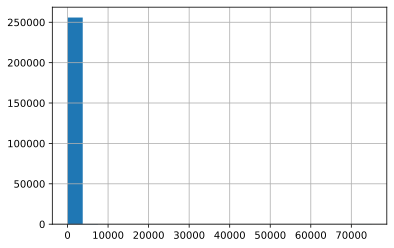

In [51]:
# df = data.copy()
df.baths = (df.baths.str.replace('Bathrooms: ', '').str.replace(' Baths', '').str.replace('baths', '')
            .str.replace(',', '').str.replace('~', '1').str.replace(' ', '').str.replace('+', '1')
            .str.replace('0/0', '0').str.replace('Sq.Ft.', '').str.replace('ba', '').str.replace('--', '')
            .str.replace('1-0/1-0/1', '').str.replace('—', '').str.replace('2ths', '').str.replace('116/116/116', '')
            .str.replace('SemiMod', '').str.replace('3-1/2-2', '').str.replace('1/1/1/1', '')
            .str.replace('2-1/2-1/1-1/1-1', '').str.replace('1/-0', '').str.replace('1-2', ''))
df.loc[df.baths == '', 'baths'] = 1
df.baths = pd.to_numeric(df.baths)
df.baths.hist(bins=20)

Видно, что есть выбросы

In [52]:
df[df.baths > 30].sample(3)

,status,private pool,propertyType,street,baths,homeFacts,fireplace,city,schools,sqft,...,target,Year built,Remodeled year,Heating,Cooling,Parking,lotsize,Price/sqft,house_num,street_name
99402,active,NaN,houses,1240 wren ct unit h,2250.0,"{'atAGlanceFacts': [{'factValue': '2019', 'fac...",NaN,Longmont,"[{'rating': ['4', '3', '8'], 'data': {'Distanc...","1,675",...,339900.0,2019,,,,,—,$203 / Sq. Ft.,1240,wren ct
309654,active,NaN,houses,9383 lands point st,2500.0,"{'atAGlanceFacts': [{'factValue': '1984', 'fac...",1,San Antonio,"[{'rating': ['7', '6', '7'], 'data': {'Distanc...","1,187",...,169000.0,1984,,Electric Heat,Central Heating,,"6,600 Sq. Ft.",$142 / Sq. Ft.,9383,lands point st
20229,active,NaN,houses,1910 s dearborn st,2000.0,"{'atAGlanceFacts': [{'factValue': '2002', 'fac...",1,Seattle,"[{'rating': ['3', '7', '5', '1', '6', '6'], 'd...","2,980",...,1050000.0,2002,,Garage-Gas,"Central Air Conditioning, Forced Air Heating",,"3,900 Sq. Ft.",$352 / Sq. Ft.,1910,s dearborn st


In [53]:
# Создадим median_baths с медианным количеством baths для каждого значения propertyType
median_baths = df.groupby(['propertyType'])['baths'].median().reset_index()
median_baths.loc[median_baths['propertyType'] ==
                 'other style', 'baths'] = df.baths.median()
median_baths

,propertyType,baths
0,condos/coops,2.0
1,houses,3.0
2,lots/land,0.0
3,manufactured,2.0
4,multi-family,3.0
5,other style,2.5
6,townhomes,3.0


In [54]:
# Создадим датасет с замененым количеством baths более 30 на медианные значения
df_baths = pd.merge(df[df.baths > 30].drop('baths', axis=1), median_baths, left_on=[
    'propertyType'], right_on=['propertyType'], how='left')

# удалим строки со значением baths > 30
df.drop(df[df.baths > 30].index, inplace=True)

# Вставим строки с измененным количеством baths
df = df.append(df_baths)
df.sample()

,status,private pool,propertyType,street,baths,homeFacts,fireplace,city,schools,sqft,...,target,Year built,Remodeled year,Heating,Cooling,Parking,lotsize,Price/sqft,house_num,street_name
43332,for sale,NaN,houses,4556 marisabel azcarate,3.0,"{'atAGlanceFacts': [{'factValue': '', 'factLab...",NaN,El Paso,"[{'rating': ['5/10', '7/10', '8/10'], 'data': ...","1,779 sqft",...,201950.0,,,,,,5227 sqft,$114/sqft,4556,marisabel azcarate


In [55]:
# проверим строки со значением baths > 30
df[df.baths > 30]

,status,private pool,propertyType,street,baths,homeFacts,fireplace,city,schools,sqft,...,target,Year built,Remodeled year,Heating,Cooling,Parking,lotsize,Price/sqft,house_num,street_name


<AxesSubplot:>

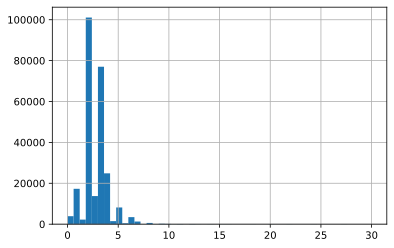

In [56]:
df.baths.hist(bins=50)

## 5.8. fireplace

In [57]:
# проверим значения
df.fireplace.value_counts().head(15)

yes                 48181
Yes                 19708
1                   12702
2                    2016
Not Applicable       1988
Fireplace             830
3                     399
Living Room           368
Gas/Gas Logs          296
No                    289
LOCATION              289
Fireplace YN          287
Special Features      271
1 Fireplace           256
Wood Burning          247
Name: fireplace, dtype: int64

Признак "камин". Произведем изменения

In [58]:
fireplace = df.fireplace.fillna('0').copy()
fireplace = fireplace.str.lower()
repl_dct = {'not applicable': '0', 'wood': '1', 'gas': '1', 'yes': '1', 'fireplace': '1', 'room': '1',
            'location': '1', 'familyrm': '1', 'electric': '1', 'firepit': '1', 'ceiling fan': '0',
            'utility connection': '0', 'closets': '0', 'special features': '0', 'n/k': '0', 'two': '2',
            'decorative': '0', 'basement, den': '2', 'den': '1', 'see remarks': '0',
            'in-law quarters': '1', 'one, propane logs convey': '1', 'extras': '1', 'insert': '1',
            'masonry': '1', 'free standing': '1', 'factory built': '1', 'fire': '1', 'storage': '0',
            'stone': '1', 'dining': '1', 'direct vent': '0', 'four or more': '4', 'redecorated': '1',
            'three or more': '3', 'see agent': '1', 'brick': '1', 'number': '1', 'features': '0',
            'smthr': '1', 'basement': '1', 'smapl': '1', 'see through': '1', 'wet bar': '1', 'one': '1',
            'pellet': '1', 'coal': '1', 'propane': '1', 'living': '1', 'metal': '1', 'kitchen': '1'}

for repl in repl_dct:
    for_repl = repl
    to_repl = repl_dct[for_repl]
    fireplace[fireplace.str.contains(for_repl, na=False)] = to_repl

fireplace = fireplace.str.replace('+', '')
fireplace[fireplace == 'no'] = '0'
fireplace[(fireplace.str.len() > 2) & (fireplace != 'decorative')] = '0'

# # Заменим пропущенные значения
# fireplace = fireplace.fillna('0')

df.fireplace = fireplace

# проверим изменения
df.fireplace.value_counts().head(15)

0     240414
1      89183
2       2029
3        434
4        108
5         27
6         10
7          6
8          2
10         1
9          1
Name: fireplace, dtype: int64

<AxesSubplot:>

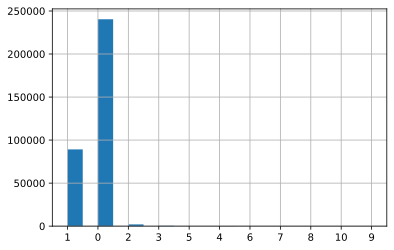

In [59]:
# Посмотрим на распределение
df.fireplace.hist(bins=20)

В большинстве случаев (274996) камин отсутствует. Один камин присутствует в 95133 случаях

## 5.9. city

In [60]:
df.city.value_counts()

Houston             21706
San Antonio         14388
Miami               13363
Jacksonville         8555
Dallas               8016
                    ...  
Millican                1
Hallandale Beach        1
AVENTURA                1
Freeland                1
Nashport                1
Name: city, Length: 1939, dtype: int64

Признак "город". Вариантов городов - 2024. Произведем изменения

In [61]:
df.city = df.city.str.lower()

In [62]:
df.city.value_counts()

houston              21706
san antonio          14388
miami                13366
jacksonville          8558
dallas                8018
                     ...  
leona valley             1
noblesville              1
chinatown                1
perdido key              1
arlington heights        1
Name: city, Length: 1843, dtype: int64

Вариантов городов стало - 1908

In [63]:
# Количество пропушенных значений
df.city.isnull().sum()

34

In [64]:
# Посмотрим на пропущенные значения
df[df.city.isnull()]

,status,private pool,propertyType,street,baths,homeFacts,fireplace,city,schools,sqft,...,target,Year built,Remodeled year,Heating,Cooling,Parking,lotsize,Price/sqft,house_num,street_name
6931,active,NaN,houses,13155 w highway 316,2.0,"{'atAGlanceFacts': [{'factValue': '2000', 'fac...",0,NaN,"[{'rating': ['1', '4', '3', '3', '6', '6'], 'd...",1016,...,1495000.0,2000,,Central Heat,"Ceiling Fans, Central Cooling",Covered Parking,None,"$1,471",13155,w highway 316
18981,active,NaN,lots/land,se 117th ter,NaN,"{'atAGlanceFacts': [{'factValue': '', 'factLab...",0,NaN,"[{'rating': [], 'data': {'Distance': [], 'Grad...",0,...,49900.0,,,,,,428195,None,None,se 117th ter
23311,active,NaN,lots/land,blk 4 n america lareedo rd lot 8,NaN,"{'atAGlanceFacts': [{'factValue': '', 'factLab...",0,NaN,"[{'rating': [], 'data': {'Distance': [], 'Grad...",0,...,417718.0,,,,,,118919,None,None,blk 4 n america lareedo rd lot 8
53743,active,NaN,lots/land,ocala,NaN,"{'atAGlanceFacts': [{'factValue': '', 'factLab...",0,NaN,"[{'rating': [], 'data': {'Distance': [], 'Grad...",0,...,31334.0,,,,,,40075,None,None,ocala
71802,active,NaN,lots/land,unditermined unditermined,NaN,"{'atAGlanceFacts': [{'factValue': '', 'factLab...",0,NaN,"[{'rating': [], 'data': {'Distance': [], 'Grad...",0,...,28000.0,,,,,,56127,None,None,unditermined unditermined
107749,active,NaN,lots/land,sw149 ter,NaN,"{'atAGlanceFacts': [{'factValue': '', 'factLab...",0,NaN,"[{'rating': [], 'data': {'Distance': [], 'Grad...",0,...,18000.0,,,,,,22000,None,None,sw149 ter
108744,for rent,NaN,lots/land,26484 deer rd,NaN,"{'atAGlanceFacts': [{'factValue': '', 'factLab...",0,NaN,"[{'rating': ['6', '5', '7', '7', '2', '10', 'N...",0,...,4000.0,,,,,,8000,None,26484,deer rd
114990,for sale,Yes,houses,20003 mar rojo y mar egeo,6.0,"{'atAGlanceFacts': [{'factValue': '2000', 'fac...",0,NaN,"[{'rating': ['5/10', 'NA', '4/10'], 'data': {'...","Total interior livable area: 5,905 sqft",...,1650000.0,2000,,Electric,,"Carport, Attached Garage",-- sqft lot,$279,20003,mar rojo y mar egeo
115609,for rent,NaN,lots/land,19212 roosevelt,NaN,"{'atAGlanceFacts': [{'factValue': '', 'factLab...",0,NaN,"[{'rating': ['5', '4', '6', 'NR', '5', 'NR', '...",0,...,4200.0,,,,,,10001,None,19212,roosevelt
133809,active,NaN,lots/land,ocala,NaN,"{'atAGlanceFacts': [{'factValue': '', 'factLab...",0,NaN,"[{'rating': [], 'data': {'Distance': [], 'Grad...",0,...,31334.0,,,,,,40075,None,None,ocala


Скорее всего это не ошибка. Просто некоторые дома или участки находятся вне города. Заменим эти значения на "nocity"

In [65]:
df.loc[df.city.isnull(), 'city'] = 'nocity'

# Посмотрим на пропущенные значения
df[df.city.isnull()]

,status,private pool,propertyType,street,baths,homeFacts,fireplace,city,schools,sqft,...,target,Year built,Remodeled year,Heating,Cooling,Parking,lotsize,Price/sqft,house_num,street_name


Замена произведена

## 5.10. schools

In [66]:
df.schools

0       [{'rating': ['4', '4', '7', 'NR', '4', '7', 'N...
1       [{'rating': ['4/10', 'None/10', '4/10'], 'data...
2       [{'rating': ['8/10', '4/10', '8/10'], 'data': ...
3       [{'rating': ['9/10', '9/10', '10/10', '9/10'],...
4       [{'rating': ['4/10', '5/10', '5/10'], 'data': ...
                              ...                        
9040    [{'rating': ['5', '5', '2', '10'], 'data': {'D...
9041    [{'rating': ['7', 'NR', '8', 'NR', '3'], 'data...
9042    [{'rating': ['5', '6', '6'], 'data': {'Distanc...
9043    [{'rating': ['6', '3', '4', '10'], 'data': {'D...
9044    [{'rating': ['4', '10', 'NR', '2', '2'], 'data...
Name: schools, Length: 332215, dtype: object

Признак - 'школа'. Можно предположить, что сохранены данные о ближайших школах

In [67]:
# посмотрим на отдельные значение
df.schools[0]

0    [{'rating': ['4', '4', '7', 'NR', '4', '7', 'N...
0    [{'rating': ['7', '10', 'NR', '4', '4'], 'data...
Name: schools, dtype: object

In [68]:
df.schools[332214]

"[{'rating': ['5/10', '4/10', '3/10'], 'data': {'Distance': ['0.3 mi', '1.1 mi', '4.1 mi'], 'Grades': ['PK-5', '6-8', '9-12']}, 'name': ['Mary Lou Hartman', 'Woodlake Hills Middle School', 'Judson High School']}]"

Некоторые значения имеют включения символа '\\'

In [69]:
# Удалим символ '\'
df.schools = df.schools.str.replace("\'", "'")

# Посмотрим, что получилось
df.schools[0]

0    [{'rating': ['4', '4', '7', 'NR', '4', '7', 'N...
0    [{'rating': ['7', '10', 'NR', '4', '4'], 'data...
Name: schools, dtype: object

Из сети мы узнали что в США школьная система образования включает 3 этапа:
- начальная школа (elementary school)
- средняя школа (middle school)
- высшая (старшая) школа (high school)
Также имеются частные школы (privat school) 

У каждой государственной школы должен быть рейтинг. Чем выше рейтинг школы вблизи от дома, тем выше стоимость жилья.

Создадим функцию для создания новых признаков из признаков о школах вблизи дома:
- Количество начальных школ
- Средний рейтинг начальных школ 
- Среднее расстояние до начальной школы
- Количество средних школ
- Средний рейтинг средних школ 
- Среднее расстояние до средней школы
- Количество высших школ
- Средний рейтинг высших школ 
- Среднее расстояние до высшей школы
- Количество частных школ
- Среднее расстояние до частной школы

В предоставленных данных отсутствует рейтинг для частных школ, поэтому его мы не учитываем

In [70]:
# def schools_features(value):
#     # функция принимает на вход значение ячейки schools и разделяет ее на  признаки:
#     """- Количество начальных школ
#         - Средний рейтинг начальных школ
#         - Среднее расстояние до начальной школы
#         - Количество средних школ
#         - Средний рейтинг средних школ
#         - Среднее расстояние до средней школы
#         - Количество высших школ
#         - Средний рейтинг высших школ
#         - Среднее расстояние до высшей школы
#         - Количество частных школ
#         - Среднее расстояние до частной школы"""
#     # Приводим значение к нижнему регистру
#     value = value.lower()

#     # Составляем список названий школ
#     try:
#         name_school = re.findall("(name': \[)([\s\S]+)(]})", value, flags=0)[0][1]

#         name_school = re.findall('''[^(, )]([\s\S]+?)( school)['"]''', name_school, flags=0)
#         name_school = [n + m for n, m in name_school]
# #         name_school = name_school
#     except:
#         name_school = None

#     # Составляем список рейтингов школ
#     try:
#         rating_school = re.findall("(rating': \[)([\s\S]+?)(])", value, flags=0)[0][1]
#         rating_school = rating_school.split(', ')
#     except:
#         rating_school = None
# #     print(rating_school)

#     # Составляем список дистанций от дома до школы
#     try:
#         distance_school = re.findall("(distance': \[)([\s\S]+?)(])", value, flags=0)[0][1]
#         distance_school = distance_school.split(', ')
#     except:
#         distance_school = None


#     val_dct = {}
#     val_lst = []
# #     school_dct = {}
#     if name_school!= None:
#         for i in range(len(name_school)):
# #             school_dct = {}
#             if i>60:
#                 print(value)
#             # Создаем список со списками наименований школ, рейтингов школ и дистанций до школ
#             val_lst.append([name_school[i], rating_school[i].replace("'", '').replace("/10", '').replace(" ", '').replace("none", '1').replace("na", 'nr'),
#                             distance_school[i].replace("'", '').replace("mi", '').replace(" ", '')])

#     # Преобразуем список в датафрейм
#     df_school = pd.DataFrame.from_records(val_lst)

#     elem_scl_mean_rat = elem_scl_mean_dist = elem_scl_mean_count = mid_scl_mean_rat = \
#                 mid_scl_mean_dist = mid_scl_mean_count = high_scl_mean_rat = high_scl_mean_dist = \
#                high_scl_mean_count = priv_scl_mean_rat = priv_scl_mean_dist = priv_scl_mean_count = None
#     # Если датафрейм не пустой создаем из него отдельные датафреймы для различных категорий школ по названию
#     if len(df_school)>0:
#         elementary_school = df_school[(df_school[0].str.contains('elementary'))&(~df_school[1].str.contains('nr'))]
#         middle_school = df_school[((df_school[0].str.contains('middle'))|(df_school[0].str.contains('intermediate')))&(~df_school[1].str.contains('nr'))]
#         high_school = df_school[(df_school[0].str.contains('high')|(df_school[0].str.contains('science')))
#                                 &(~df_school[1].str.contains('nr'))]
#         privat_school = df_school[~df_school.index.isin([elementary_school.index, middle_school.index, high_school.index])]

# #         elem_scl_mean_rat = elem_scl_mean_dist = elem_scl_mean_count = mid_scl_mean_rat = \
# #                 mid_scl_mean_dist = mid_scl_mean_count = high_scl_mean_rat = high_scl_mean_dist = \
# #                high_scl_mean_count = priv_scl_mean_rat = priv_scl_mean_dist = priv_scl_mean_count = None
#         # Считаем средний рейтинг, среднее расстояние и количество для начальных школ
#         if len(elementary_school)>0:
#             elem_scl_mean_rat = elementary_school[1].astype(float).mean()
#             elem_scl_mean_dist = elementary_school[2].astype(float).mean()
#             elem_scl_mean_count = len(elementary_school)
#         # Считаем средний рейтинг, среднее расстояние и количество для средних школ
#         if len(middle_school)>0:
#             mid_scl_mean_rat = middle_school[1].astype(float).mean()
#             mid_scl_mean_dist = middle_school[2].astype(float).mean()
#             mid_scl_mean_count = len(middle_school)
#         # Считаем средний рейтинг, среднее расстояние и количество для высших школ
#         if len(high_school)>0:
#             high_scl_mean_rat = high_school[1].astype(float).mean()
#             high_scl_mean_dist = high_school[2].astype(float).mean()
#             high_scl_mean_count = len(high_school)
#         # Считаем среднее расстояние и количество для частных школ
#         if len(privat_school)>0:
#             priv_scl_mean_dist = privat_school[2].astype(float).mean()
#             priv_scl_mean_count = len(privat_school)

#     schools_feature = [elem_scl_mean_rat, elem_scl_mean_dist, elem_scl_mean_count, mid_scl_mean_rat,
#             mid_scl_mean_dist, mid_scl_mean_count, high_scl_mean_rat, high_scl_mean_dist,
#            high_scl_mean_count, priv_scl_mean_dist, priv_scl_mean_count]
# #     print(schools_feature)
#     return schools_feature


# schools = df.schools.copy()
# schools_feature= schools.apply(schools_features)
# school_df = pd.DataFrame.from_records(data = np.array(schools_feature), columns=['elem_scl_mean_rat', 'elem_scl_mean_dist',
#                                                                        'elem_scl_mean_count', 'mid_scl_mean_rat',
#             'mid_scl_mean_dist', 'mid_scl_mean_count', 'high_scl_mean_rat', 'high_scl_mean_dist',
#            'high_scl_mean_count', 'priv_scl_mean_dist', 'priv_scl_mean_count'], index=df.index)

# # Посмотрим на полученные значения
# school_df

In [71]:
# school_df.to_csv('data\scholl_feature.csv')

In [72]:
school_df = pd.read_csv('data\scholl_feature.csv', index_col='Unnamed: 0')
school_df

,elem_scl_mean_rat,elem_scl_mean_dist,elem_scl_mean_count,mid_scl_mean_rat,mid_scl_mean_dist,mid_scl_mean_count,high_scl_mean_rat,high_scl_mean_dist,high_scl_mean_count,priv_scl_mean_dist,priv_scl_mean_count
0,4.0,2.70,1.0,4.0,7.05,2.0,7.0,8.850,2.0,5.537500,8.0
1,1.0,1.32,1.0,4.0,1.65,1.0,4.0,1.650,1.0,1.485000,2.0
2,NaN,NaN,NaN,8.0,1.19,1.0,6.0,2.345,2.0,1.960000,3.0
3,9.0,0.10,1.0,9.5,1.05,2.0,9.5,0.930,2.0,0.970000,3.0
4,5.0,3.03,1.0,4.0,5.96,1.0,5.0,3.250,1.0,5.960000,1.0
...,...,...,...,...,...,...,...,...,...,...,...
9040,5.0,0.80,1.0,NaN,NaN,NaN,5.0,1.200,1.0,0.750000,2.0
9041,7.0,0.20,1.0,8.0,0.30,1.0,NaN,NaN,NaN,0.250000,2.0
9042,5.0,0.20,1.0,6.0,0.30,1.0,6.0,1.400,1.0,0.800000,2.0
9043,6.0,1.00,1.0,3.0,0.80,1.0,4.0,0.900,1.0,3.333333,3.0


In [73]:
# Присоединим полученые значения к датафрейму
df = pd.concat([df, school_df], axis=1)
df

,status,private pool,propertyType,street,baths,homeFacts,fireplace,city,schools,sqft,...,elem_scl_mean_dist,elem_scl_mean_count,mid_scl_mean_rat,mid_scl_mean_dist,mid_scl_mean_count,high_scl_mean_rat,high_scl_mean_dist,high_scl_mean_count,priv_scl_mean_dist,priv_scl_mean_count
0,active,NaN,houses,240 heather ln,3.5,"{'atAGlanceFacts': [{'factValue': '2019', 'fac...",1,southern pines,"[{'rating': ['4', '4', '7', 'NR', '4', '7', 'N...",2900,...,2.70,1.0,4.0,7.05,2.0,7.0,8.850,2.0,5.537500,8.0
1,for sale,NaN,houses,12911 e heroy ave,3.0,"{'atAGlanceFacts': [{'factValue': '2019', 'fac...",0,spokane valley,"[{'rating': ['4/10', 'None/10', '4/10'], 'data...","1,947 sqft",...,1.32,1.0,4.0,1.65,1.0,4.0,1.650,1.0,1.485000,2.0
2,for sale,NaN,houses,2005 westridge rd,2.0,"{'atAGlanceFacts': [{'factValue': '1961', 'fac...",1,los angeles,"[{'rating': ['8/10', '4/10', '8/10'], 'data': ...","3,000 sqft",...,NaN,NaN,8.0,1.19,1.0,6.0,2.345,2.0,1.960000,3.0
3,for sale,NaN,houses,4311 livingston ave,8.0,"{'atAGlanceFacts': [{'factValue': '2006', 'fac...",1,dallas,"[{'rating': ['9/10', '9/10', '10/10', '9/10'],...","6,457 sqft",...,0.10,1.0,9.5,1.05,2.0,9.5,0.930,2.0,0.970000,3.0
4,for rent,NaN,lots/land,1524 kiscoe st,NaN,"{'atAGlanceFacts': [{'factValue': '', 'factLab...",0,palm bay,"[{'rating': ['4/10', '5/10', '5/10'], 'data': ...",NaN,...,3.03,1.0,4.0,5.96,1.0,5.0,3.250,1.0,5.960000,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9040,active,NaN,townhomes,3811 throckmorton st,3.0,"{'atAGlanceFacts': [{'factValue': '2015', 'fac...",1,dallas,"[{'rating': ['5', '5', '2', '10'], 'data': {'D...","2,785",...,0.80,1.0,NaN,NaN,NaN,5.0,1.200,1.0,0.750000,2.0
9041,active,NaN,houses,235 emerson st nw #104,3.0,"{'atAGlanceFacts': [{'factValue': '1929', 'fac...",0,washington,"[{'rating': ['7', 'NR', '8', 'NR', '3'], 'data...",700,...,0.20,1.0,8.0,0.30,1.0,NaN,NaN,NaN,0.250000,2.0
9042,active,NaN,houses,5919 w harrow dr,3.0,"{'atAGlanceFacts': [{'factValue': '2001', 'fac...",1,houston,"[{'rating': ['5', '6', '6'], 'data': {'Distanc...","1,597",...,0.20,1.0,6.0,0.30,1.0,6.0,1.400,1.0,0.800000,2.0
9043,active,NaN,townhomes,10578 high hollows dr #269,3.0,"{'atAGlanceFacts': [{'factValue': '1970', 'fac...",1,dallas,"[{'rating': ['6', '3', '4', '10'], 'data': {'D...","1,709",...,1.00,1.0,3.0,0.80,1.0,4.0,0.900,1.0,3.333333,3.0


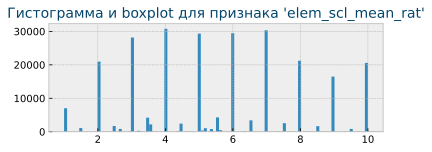

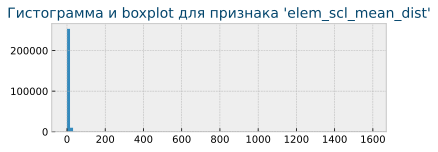

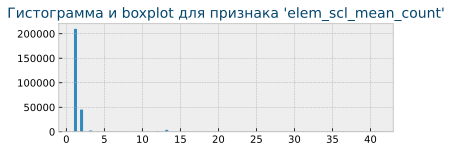

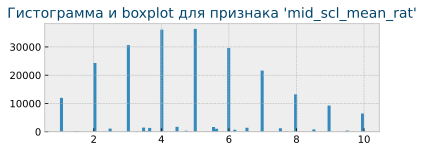

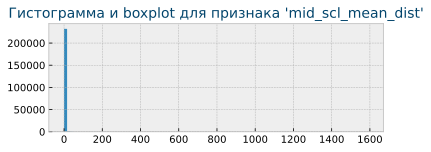

...

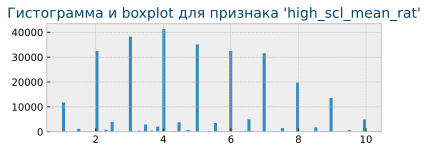

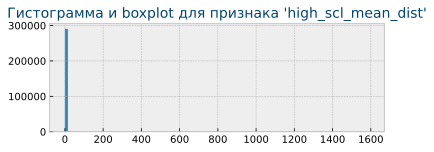

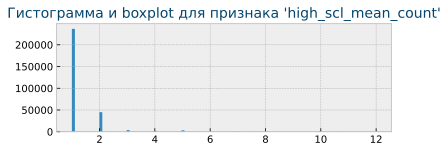

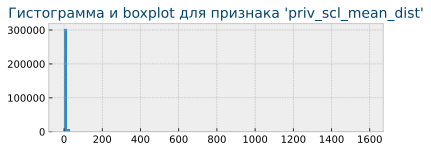

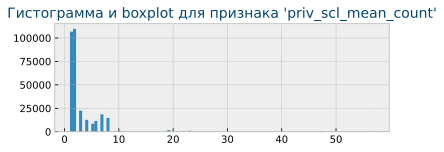

In [74]:
columns_lst = ['elem_scl_mean_rat', 'elem_scl_mean_dist', 'elem_scl_mean_count', 'mid_scl_mean_rat',
               'mid_scl_mean_dist', 'mid_scl_mean_count', 'high_scl_mean_rat', 'high_scl_mean_dist',
               'high_scl_mean_count', 'priv_scl_mean_dist', 'priv_scl_mean_count']


# Посмотрим на распределение для различных признаков у школ
for col in columns_lst:
    show_hist(df[col], col, bins=100)

Имеются выбросы для расстояний до школ. Посмотрим на выбросы:

In [75]:
# посмотрим на выбросы в расстоянии до начальной школы
df[df['elem_scl_mean_dist'] > 300]

,status,private pool,propertyType,street,baths,homeFacts,fireplace,city,schools,sqft,...,elem_scl_mean_dist,elem_scl_mean_count,mid_scl_mean_rat,mid_scl_mean_dist,mid_scl_mean_count,high_scl_mean_rat,high_scl_mean_dist,high_scl_mean_count,priv_scl_mean_dist,priv_scl_mean_count
23280,unknown,NaN,houses,73 park rd,4.0,"{'atAGlanceFacts': [{'factValue': '1980', 'fac...",0,falcon heights,"[{'rating': ['10/10', '5/10', '4/10'], 'data':...","6,000",...,312.70,1.0,5.0,312.40,1.0,4.0,312.60,1.0,312.650000,2.0
89167,for sale,NaN,houses,1695 milam st,6.0,"{'atAGlanceFacts': [{'factValue': '1958', 'fac...",0,beaumont,"[{'rating': ['2/10', '2/10', '4/10'], 'data': ...","5,920 sqft",...,365.68,1.0,2.0,0.24,1.0,2.0,1.46,1.0,1.460000,1.0
96975,for sale,NaN,houses,108 n nbelvedere blvd #29,NaN,"{'atAGlanceFacts': [{'factValue': '1963', 'fac...",1,santa ana,"[{'rating': ['3/10', '1/10', '4/10'], 'data': ...",890 sqft,...,1590.36,1.0,1.0,1591.00,1.0,4.0,1591.06,1.0,1590.710000,2.0
116527,for sale,NaN,lots/land,milam st #3,NaN,"{'atAGlanceFacts': [{'factValue': '', 'factLab...",0,beaumont,"[{'rating': ['2/10', '2/10', '4/10'], 'data': ...",NaN,...,365.42,1.0,2.0,0.46,1.0,2.0,1.38,1.0,1.380000,1.0
149206,for sale,NaN,houses,253 w wnorwood ave,NaN,"{'atAGlanceFacts': [{'factValue': '1950', 'fac...",1,spring,"[{'rating': ['9/10', '9/10', '6/10', '6/10'], ...",720 sqft,...,464.25,1.0,6.0,464.49,1.0,9.0,462.59,2.0,463.223333,3.0
179636,for sale,NaN,houses,5600 pine tree dr,6.0,"{'atAGlanceFacts': [{'factValue': '1949', 'fac...",0,miami beach,"[{'rating': ['4/10', '7/10'], 'data': {'Distan...","4,173 sqft",...,1187.14,1.0,NaN,NaN,NaN,4.0,1187.88,1.0,1187.880000,1.0
198612,for sale,NaN,lots/land,2790 crockett st,NaN,"{'atAGlanceFacts': [{'factValue': '', 'factLab...",0,beaumont,"[{'rating': ['2/10', '2/10', '4/10'], 'data': ...",NaN,...,365.58,1.0,2.0,0.90,1.0,2.0,0.79,1.0,0.790000,1.0
314297,for sale,NaN,houses,108 n nbelvedere blvd #12,NaN,"{'atAGlanceFacts': [{'factValue': '1963', 'fac...",1,santa ana,"[{'rating': ['3/10', '1/10', '4/10'], 'data': ...",890 sqft,...,1590.38,1.0,1.0,1591.02,1.0,4.0,1591.09,1.0,1590.735000,2.0


In [76]:
# рассмотрим повнимательнее данные о школах в отдельном предложении
df.iloc[26187].schools

"[{'rating': ['6/10', '7/10', '8/10'], 'data': {'Distance': ['0.4 mi', '4.6 mi', '4.8 mi'], 'Grades': ['K-5', '6-8', '9-12']}, 'name': ['Wilson Elementary School', 'Siegel Middle School', 'Siegel High School']}]"

Школы не могут находиться на таком расстоянии. Заменим расстояние до школ свыше 35 миль на среднее значение

In [77]:
# Проверим средние значения от дома до школ различных категорий
mean_elem_scl_dist = df['elem_scl_mean_dist'].mean()
mean_midl_scl_dist = df['mid_scl_mean_dist'].mean()
mean_high_scl_dist = df['high_scl_mean_dist'].mean()
mean_priv_scl_dist = df['priv_scl_mean_dist'].mean()
# df.loc[df['elem_scl_mean_dist']>35, 'elem_scl_mean_dist'] =
mean_elem_scl_dist, mean_midl_scl_dist, mean_high_scl_dist, mean_priv_scl_dist

(2.8570306178305223,
 2.6530780651320525,
 2.8413746549282415,
 3.1150499212754683)

In [78]:
# Произведем замены
df.loc[df['elem_scl_mean_dist'] > 35,
       'elem_scl_mean_dist'] = mean_elem_scl_dist
df.loc[df['mid_scl_mean_dist'] > 35, 'mid_scl_mean_dist'] = mean_midl_scl_dist
df.loc[df['high_scl_mean_dist'] > 35,
       'high_scl_mean_dist'] = mean_high_scl_dist
df.loc[df['priv_scl_mean_dist'] > 35,
       'priv_scl_mean_dist'] = mean_priv_scl_dist

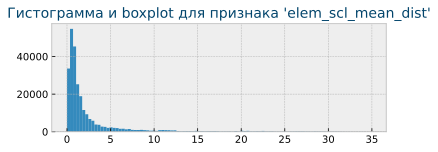

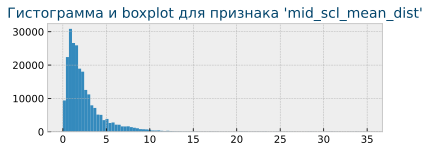

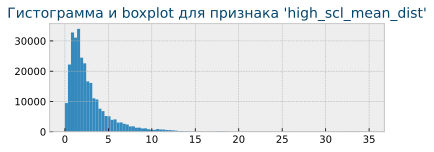

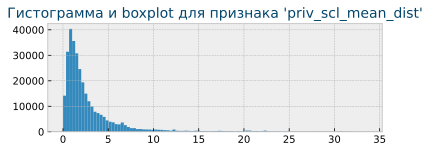

In [79]:
# Посмотрим, что получилось
columns_lst = ['elem_scl_mean_dist', 'mid_scl_mean_dist',
               'high_scl_mean_dist', 'priv_scl_mean_dist']
for col in columns_lst:
    show_hist(df[col], col, bins=100)

Отлично! В дальнейшем произведем нормализацию этого признака

In [80]:
# проверим пропущенные значения
columns_lst = ['elem_scl_mean_rat', 'elem_scl_mean_dist', 'elem_scl_mean_count', 'mid_scl_mean_rat',
               'mid_scl_mean_dist', 'mid_scl_mean_count', 'high_scl_mean_rat', 'high_scl_mean_dist',
               'high_scl_mean_count', 'priv_scl_mean_dist', 'priv_scl_mean_count']
for col in columns_lst:
    print(
        f'Признак -{col}, количество пропущенных значений - {df[col].isnull().sum()}')

Признак -elem_scl_mean_rat, количество пропущенных значений - 68315
Признак -elem_scl_mean_dist, количество пропущенных значений - 68315
Признак -elem_scl_mean_count, количество пропущенных значений - 68315
Признак -mid_scl_mean_rat, количество пропущенных значений - 98280
Признак -mid_scl_mean_dist, количество пропущенных значений - 98280
Признак -mid_scl_mean_count, количество пропущенных значений - 98280
Признак -high_scl_mean_rat, количество пропущенных значений - 39850
Признак -high_scl_mean_dist, количество пропущенных значений - 39850
Признак -high_scl_mean_count, количество пропущенных значений - 39850
Признак -priv_scl_mean_dist, количество пропущенных значений - 20213
Признак -priv_scl_mean_count, количество пропущенных значений - 20213


In [81]:
# Заменим пропущенные значения среднего рейтинга и количества школ на 0, а среднюю дистанцию на 35
non_rating_count_scl_lst = ['elem_scl_mean_rat', 'elem_scl_mean_count', 'mid_scl_mean_rat',
                            'mid_scl_mean_count', 'high_scl_mean_rat', 'high_scl_mean_count', 'priv_scl_mean_count']
for col in non_rating_count_scl_lst:
    df.loc[df[col].isnull(), col] = 0

non_dist_scl_lst = ['elem_scl_mean_dist', 'mid_scl_mean_dist',
                    'high_scl_mean_dist', 'priv_scl_mean_dist']
for col in non_dist_scl_lst:
    df.loc[df[col].isnull(), col] = 35

In [82]:
# проверим пропущенные значения
columns_lst = ['elem_scl_mean_rat', 'elem_scl_mean_dist', 'elem_scl_mean_count', 'mid_scl_mean_rat',
               'mid_scl_mean_dist', 'mid_scl_mean_count', 'high_scl_mean_rat', 'high_scl_mean_dist',
               'high_scl_mean_count', 'priv_scl_mean_dist', 'priv_scl_mean_count']
for col in columns_lst:
    print(
        f'Признак -{col}, количество пропущенных значений - {df[col].isnull().sum()}')

Признак -elem_scl_mean_rat, количество пропущенных значений - 0
Признак -elem_scl_mean_dist, количество пропущенных значений - 0
Признак -elem_scl_mean_count, количество пропущенных значений - 0
Признак -mid_scl_mean_rat, количество пропущенных значений - 0
Признак -mid_scl_mean_dist, количество пропущенных значений - 0
Признак -mid_scl_mean_count, количество пропущенных значений - 0
Признак -high_scl_mean_rat, количество пропущенных значений - 0
Признак -high_scl_mean_dist, количество пропущенных значений - 0
Признак -high_scl_mean_count, количество пропущенных значений - 0
Признак -priv_scl_mean_dist, количество пропущенных значений - 0
Признак -priv_scl_mean_count, количество пропущенных значений - 0


In [83]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 332215 entries, 0 to 9044
Data columns (total 38 columns):
 #   Column               Non-Null Count   Dtype  
---  ------               --------------   -----  
 0   status               332215 non-null  object 
 1   private pool         4021 non-null    object 
 2   propertyType         332215 non-null  object 
 3   street               332215 non-null  object 
 4   baths                256153 non-null  float64
 5   homeFacts            332215 non-null  object 
 6   fireplace            332215 non-null  object 
 7   city                 332215 non-null  object 
 8   schools              332215 non-null  object 
 9   sqft                 310421 non-null  object 
 10  zipcode              332215 non-null  object 
 11  beds                 267205 non-null  object 
 12  state                332215 non-null  object 
 13  stories              212984 non-null  object 
 14  mls-id               24555 non-null   object 
 15  PrivatePool        

## 5.11. sqft

In [84]:
df.sqft

0             2900
1       1,947 sqft
2       3,000 sqft
3       6,457 sqft
4              NaN
           ...    
9040         2,785
9041           700
9042         1,597
9043         1,709
9044           920
Name: sqft, Length: 332215, dtype: object

Признак - "площадь дома в квадратных футах". Преобразуем в числовой признак

In [85]:
df.sqft = df.sqft.str.replace(r'\D+', '', regex=True)
df.sqft = pd.to_numeric(df.sqft)
df.sqft = df.sqft.fillna(0)
df.sqft

0       2900.0
1       1947.0
2       3000.0
3       6457.0
4          0.0
         ...  
9040    2785.0
9041     700.0
9042    1597.0
9043    1709.0
9044     920.0
Name: sqft, Length: 332215, dtype: float64

<AxesSubplot:>

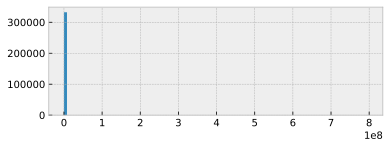

In [86]:
# Посмотрим на распределение признака
df.sqft.hist(bins=100)

Имеется большой разброс в значениях. Посмотрим выбросы это или нет

In [87]:
df[(df.sqft > 7000) & (df.target < 1500000)]

,status,private pool,propertyType,street,baths,homeFacts,fireplace,city,schools,sqft,...,elem_scl_mean_dist,elem_scl_mean_count,mid_scl_mean_rat,mid_scl_mean_dist,mid_scl_mean_count,high_scl_mean_rat,high_scl_mean_dist,high_scl_mean_count,priv_scl_mean_dist,priv_scl_mean_count
78,for sale,NaN,condos/coops,8470 129th st #4a,2.0,"{'atAGlanceFacts': [{'factValue': '1969', 'fac...",0,kew gardens,"[{'rating': ['3/10', '6/10', '7/10'], 'data': ...",107250.0,...,35.000,0.0,0.0,35.00,0.0,3.0,1.15,1.0,1.150,1.0
95,for sale,NaN,houses,29191 weybridge dr,6.0,"{'atAGlanceFacts': [{'factValue': '1997', 'fac...",1,westlake,"[{'rating': ['9/10', '9/10', '7/10', '8/10'], ...",7362.0,...,1.300,2.0,9.0,1.20,1.0,8.0,1.39,1.0,1.330,3.0
117,for sale,NaN,houses,20910 41st ave #3c,NaN,"{'atAGlanceFacts': [{'factValue': '1963', 'fac...",0,bayside,"[{'rating': ['9/10', '5/10', '10/10'], 'data':...",109200.0,...,35.000,0.0,0.0,35.00,0.0,9.0,0.51,1.0,0.510,1.0
176,for sale,NaN,condos/coops,345 w 145th st #2c2,NaN,"{'atAGlanceFacts': [{'factValue': '1957', 'fac...",0,new york,"[{'rating': ['2/10', '1/10', '2/10'], 'data': ...",225667.0,...,35.000,0.0,0.0,35.00,0.0,0.0,35.00,0.0,0.840,1.0
278,for sale,NaN,condos/coops,21015 23rd ave #6b,NaN,"{'atAGlanceFacts': [{'factValue': '1961', 'fac...",0,bayside,"[{'rating': ['9/10', '5/10', '9/10'], 'data': ...",373772.0,...,35.000,0.0,0.0,35.00,0.0,9.0,0.27,1.0,0.270,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3723,active,NaN,houses,4301 sw 95th ave,3.0,"{'atAGlanceFacts': [{'factValue': '1970', 'fac...",0,davie,"[{'rating': ['8', '8', '8'], 'data': {'Distanc...",7288.0,...,0.600,1.0,8.0,2.60,1.0,8.0,4.20,1.0,2.400,2.0
5646,active,NaN,other style,6006 w jewell ave,2.5,"{'atAGlanceFacts': [{'factValue': '1953', 'fac...",1,lakewood,"[{'rating': ['3', '1', '2', '1', 'NR'], 'data'...",7183.0,...,0.800,1.0,0.0,35.00,0.0,1.0,3.70,1.0,0.800,1.0
6273,active,NaN,houses,7446 river road pike,3.0,"{'atAGlanceFacts': [{'factValue': '2003', 'fac...",3,nashville,"[{'rating': ['4', '3', '4', '8', '3', '1'], 'd...",8340.0,...,3.000,1.0,3.5,7.15,2.0,6.0,7.65,2.0,6.775,4.0
6713,active,NaN,houses,7985 sea pearl cir,3.0,"{'atAGlanceFacts': [{'factValue': '2011', 'fac...",0,kissimmee,"[{'rating': ['4', '3', '10', '5', '6'], 'data'...",7907.0,...,11.400,1.0,3.0,11.40,1.0,10.0,12.40,1.0,7.500,2.0


In [88]:
df[(df.sqft < 100) & (df.propertyType != 'lots/land')]

,status,private pool,propertyType,street,baths,homeFacts,fireplace,city,schools,sqft,...,elem_scl_mean_dist,elem_scl_mean_count,mid_scl_mean_rat,mid_scl_mean_dist,mid_scl_mean_count,high_scl_mean_rat,high_scl_mean_dist,high_scl_mean_count,priv_scl_mean_dist,priv_scl_mean_count
14,new,NaN,houses,930 52nd st,NaN,"{'atAGlanceFacts': [{'factValue': '1905', 'fac...",0,brooklyn,"[{'rating': ['8', '8', '3'], 'data': {'Distanc...",0.0,...,35.00,0.0,0.0,35.0,0.0,8.0,0.200,1.0,0.200,1.0
48,active,NaN,townhomes,2014 eastbourne dr,2.0,"{'atAGlanceFacts': [{'factValue': '1998', 'fac...",0,southern pines,"[{'rating': ['NR', '4', '7', '4', '6', '7', 'N...",0.0,...,2.90,1.0,4.0,4.0,1.0,7.0,5.200,2.0,3.050,6.0
167,for sale,NaN,houses,3058 shire dr,NaN,"{'atAGlanceFacts': [{'factValue': '1974', 'fac...",0,pottstown,"[{'rating': ['5/10', '4/10', '5/10'], 'data': ...",0.0,...,35.00,0.0,4.0,4.1,1.0,5.0,3.100,1.0,2.650,2.0
200,for sale,NaN,condos/coops,545 n dearborn st #2511,2.0,"{'atAGlanceFacts': [{'factValue': '2003', 'fac...",0,chicago,"[{'rating': ['1/10', '4/10', '7/10'], 'data': ...",0.0,...,0.57,1.0,0.0,35.0,0.0,2.5,4.465,2.0,4.465,2.0
212,for sale,NaN,houses,2585 rosy sunrise st,NaN,"{'atAGlanceFacts': [{'factValue': '2001', 'fac...",0,las vegas,"[{'rating': ['7/10', '3/10', '4/10'], 'data': ...",0.0,...,0.80,1.0,3.0,1.0,1.0,4.0,0.200,1.0,0.500,2.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8487,active,NaN,houses,6011 sw 27 st,3.0,"{'atAGlanceFacts': [{'factValue': '2020', 'fac...",0,miami,"[{'rating': ['8', '10', 'NR', '3', '3'], 'data...",0.0,...,8.95,2.0,0.0,35.0,0.0,3.0,1.600,1.0,7.825,4.0
8512,active,NaN,houses,15121 boat st sw,3.0,"{'atAGlanceFacts': [{'factValue': '', 'factLab...",0,lakewood,"[{'rating': ['1', '6', '1'], 'data': {'Distanc...",0.0,...,0.30,1.0,6.0,1.0,1.0,1.0,3.000,1.0,1.650,2.0
8674,active,NaN,houses,3771 syracuse st,3.0,"{'atAGlanceFacts': [{'factValue': '1950', 'fac...",0,houston,"[{'rating': ['10', '7', '5'], 'data': {'Distan...",0.0,...,0.60,1.0,7.0,1.6,1.0,5.0,1.300,1.0,0.950,2.0
8713,active,NaN,houses,660 tennis club dr #108,3.0,"{'atAGlanceFacts': [{'factValue': '1973', 'fac...",0,fort lauderdale,"[{'rating': ['3', 'NR', '5', '3'], 'data': {'D...",0.0,...,0.80,1.0,0.0,35.0,0.0,5.0,1.700,1.0,0.900,3.0


Это явные выбросы площади дома. Заменим их на медианные значения площади дома посчитанного отдельно для каждого значения признака "propertyType" 

In [89]:
# создадим DataFrame с медианными значениями площади дома сгруппированными по признаку propertyType
median_propertyType_df = pd.DataFrame(df.groupby(['propertyType'])['sqft'].median()
                                      .reset_index()
                                      .rename(columns={'sqft': 'sqft_median'}))
# присоединим к нашим данным по признаку propertyType столбец c медианными значениями sqft_median
df = pd.merge(df, median_propertyType_df, left_on=[
    'propertyType'], right_on=['propertyType'], how='left')
# Для случаев выброса заменим значения столбца sqft на медианные значения sqft_median
df.loc[(((df.sqft > 7000) & (df.target < 1500000)) | ((df.sqft < 100) & (df.propertyType != 'lots/land'))), 'sqft'] = \
    df.loc[(((df.sqft > 7000) & (df.target < 1500000)) | (
        (df.sqft < 100) & (df.propertyType != 'lots/land'))), 'sqft_median']

# Удалим вспомогательный столбец sqft_median
df.drop('sqft_median', axis=1, inplace=True)

# Проверим наличие выбросов
df.loc[(((df.sqft > 7000) & (df.target < 1500000)) | (
    (df.sqft < 100) & (df.propertyType != 'lots/land')))]

,status,private pool,propertyType,street,baths,homeFacts,fireplace,city,schools,sqft,...,elem_scl_mean_dist,elem_scl_mean_count,mid_scl_mean_rat,mid_scl_mean_dist,mid_scl_mean_count,high_scl_mean_rat,high_scl_mean_dist,high_scl_mean_count,priv_scl_mean_dist,priv_scl_mean_count


In [90]:
# удалим оставшиеся выбросы
df.drop(df.loc[(((df.sqft > 7000) & (df.target < 1500000)) | (
    (df.sqft < 100) & (df.propertyType != 'lots/land')))].index, inplace=True)

Выбросы заменены

In [91]:
# Проверим пропущенные значения
df[df.sqft.isnull()].head(3)

,status,private pool,propertyType,street,baths,homeFacts,fireplace,city,schools,sqft,...,elem_scl_mean_dist,elem_scl_mean_count,mid_scl_mean_rat,mid_scl_mean_dist,mid_scl_mean_count,high_scl_mean_rat,high_scl_mean_dist,high_scl_mean_count,priv_scl_mean_dist,priv_scl_mean_count


Заменим пропущенные значения в столбце sqft на медианные значения площади дома посчитанного отдельно для каждого значения признака "propertyType"

In [92]:
# присоединим к нашим данным по признаку propertyType столбец c медианными значениями sqft_median
df = pd.merge(df, median_propertyType_df, left_on=[
    'propertyType'], right_on=['propertyType'], how='left')
# Для случаев пропуска значений заменим значения столбца sqft на медианные значения sqft_median
df.loc[df.sqft.isnull(), 'sqft'] = df.loc[df.sqft.isnull(), 'sqft_median']

# Удалим вспомогательный столбец sqft_median
df.drop('sqft_median', axis=1, inplace=True)

# Проверим наличие пропусков
df.loc[df.sqft.isnull()]

,status,private pool,propertyType,street,baths,homeFacts,fireplace,city,schools,sqft,...,elem_scl_mean_dist,elem_scl_mean_count,mid_scl_mean_rat,mid_scl_mean_dist,mid_scl_mean_count,high_scl_mean_rat,high_scl_mean_dist,high_scl_mean_count,priv_scl_mean_dist,priv_scl_mean_count


In [93]:
# Пропуски остались. Замним их на медианные значения всех строк
# df.loc[df.sqft.isnull(), 'sqft'] = df['sqft'].median()

# Пропуски остались. Удалим их
df.dropna(subset=['sqft', 'propertyType'], how='all', inplace=True)

# Проверим наличие пропусков
df.loc[df.sqft.isnull()]

,status,private pool,propertyType,street,baths,homeFacts,fireplace,city,schools,sqft,...,elem_scl_mean_dist,elem_scl_mean_count,mid_scl_mean_rat,mid_scl_mean_dist,mid_scl_mean_count,high_scl_mean_rat,high_scl_mean_dist,high_scl_mean_count,priv_scl_mean_dist,priv_scl_mean_count


<AxesSubplot:>

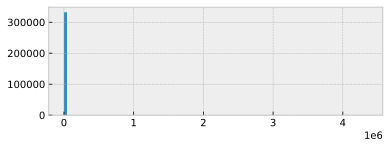

In [94]:
# Посмотрим на распределение признака
df.sqft.hist(bins=100)

В дальнейшем нормализуем данный признак

In [95]:
# # удалим строки с пропущенными значениями в столбце propertyType

df.dropna(subset=['propertyType'], inplace=True)
# df = df.reset_index(drop=True)

## 5.12. zipcode

In [96]:
df.zipcode

0         28387
1         99216
2         90049
3         75205
4         32908
          ...  
332210    75219
332211    20011
332212    77084
332213    75230
332214    33130
Name: zipcode, Length: 332215, dtype: object

Признак "почтовый индекс". Посмотрим пропущенные значения:

In [97]:
df.zipcode.isnull().sum()

0

Пропущенных значений нет

In [98]:
df.zipcode.str.len().value_counts()

5     330209
4       1783
10       215
6          3
1          3
8          1
2          1
Name: zipcode, dtype: int64

Присутствуют значения почтового индекса, которые длиной менее 5 символов и более 5 символов.

In [99]:
# Проверим значения почтового индекса длиной менее 5 знаков
df[df.zipcode.str.len() < 5].zipcode

58        8701
67        2127
109       1604
294       5488
521       2116
          ... 
322845    5452
322891    7004
323022    2210
323063    8701
323103    2131
Name: zipcode, Length: 1787, dtype: object

Это почтовые индексы у которых первыми цифрами были ноли

In [100]:
# Проверим значения почтового индекса длиной более 5 знаков
df[df.zipcode.str.len() > 5].zipcode

6501      27603-2692
7396      27603-3986
9488      27613-8607
11387     27614-9829
11443     27703-7996
             ...    
331611    27604-3789
331623    27604-1450
331652    27606-1626
331681    27606-2704
331776    27705-1944
Name: zipcode, Length: 219, dtype: object

В общем случае первые три цифры обозначают секционный центр, центр сортировки и распределения почты для области. Объект секционного центра может иметь более одного трехзначного кода, присвоенного ему. Преобразуем признак в 5 значный код

In [101]:
# Преобразуем тип столбца в строчный
zipcode = df.zipcode.astype(str)


def zipcode_transf(val):
    ''' Функция принимает на вход значение почтового индекса и если длина его менее 5 символов, 
    то добавляет к значению ноли с левой стороны. Если длин почтового индекса более 5 символов,
    то функция уменьшает почтовый индекс до 5 знаков'''
    lens_val = len(val)
#     print(val)
    if lens_val < 5:
        for i in range(5-lens_val):
            #             print(val)
            val = '0'+val
#             print(val)
    elif lens_val > 5:
        val = val[:5]
    return val


df.zipcode = zipcode.apply(zipcode_transf)

In [102]:
# Проверим короткие и длинные почтовые индексы
df[df.zipcode.str.len() != 5]

,status,private pool,propertyType,street,baths,homeFacts,fireplace,city,schools,sqft,...,elem_scl_mean_dist,elem_scl_mean_count,mid_scl_mean_rat,mid_scl_mean_dist,mid_scl_mean_count,high_scl_mean_rat,high_scl_mean_dist,high_scl_mean_count,priv_scl_mean_dist,priv_scl_mean_count


<!-- Все почтовые индексы привели к 5 значному коду. Теперь выделим первые четыре знака в отдельный столбец -->

In [103]:
df.zipcode.value_counts()

32137    2132
33131    1464
78245    1349
34747    1321
78253    1229
         ... 
48623       1
37055       1
43018       1
33083       1
95035       1
Name: zipcode, Length: 4199, dtype: int64

Имеется библиотека uszipcode из которой мы извлечем новые признаки связанные с почтовым индексом:
- population - население
- population_density - плотность населения
- land_area_in_sqmi - площадь земли
- water_area_in_sqmi - площадь воды
- housing_units - количество жилых единиц
- occupied_housing_units - количество заселенных жилых единиц
- median_home_value - медианная стоимость жилья
- median_household_income - медианная доход домохозяйства


In [104]:
# Имеется библиотека uszipcode из которой можно
# если simple_zipcode=True загружаем облегченную базу данных
search = SearchEngine(simple_zipcode=True)

# Создаем список уникальных индексов
zip_lst = df.zipcode.unique()
zipcode_dct = {}
for i in range(len(zip_lst)):
    zipcod = zip_lst[i]

    # Для уникального значения индекса загружаем необходимые данные в словарь
    zipcode = search.by_zipcode(zipcod).to_dict()
    population = zipcode['population']
    population_density = zipcode['population_density']
    land_area_in_sqmi = zipcode['land_area_in_sqmi']
    water_area_in_sqmi = zipcode['water_area_in_sqmi']
    housing_units = zipcode['housing_units']
    occupied_housing_units = zipcode['occupied_housing_units']
    median_home_value = zipcode['median_home_value']
    median_household_income = zipcode['median_household_income']
    zipcode_dct[i] = {'zipcode': zipcod, 'zip_population': population, 'zip_population_density': population_density,
                      'zip_land_area_in_sqmi': land_area_in_sqmi, 'zip_water_area_in_sqmi': water_area_in_sqmi,
                      'zip_housing_units': housing_units, 'zip_occupied_housing_units': occupied_housing_units,
                      'zip_median_home_value': median_home_value, 'zip_median_household_income': median_household_income}
# Трансформируем словарь в датафрейм
zipcode_df = pd.DataFrame.from_dict(zipcode_dct, orient='index')

# объединяем датафреймы
df = pd.merge(df, zipcode_df, left_on=[
    'zipcode'], right_on=['zipcode'], how='left')

In [105]:
# Проверим пропущенные значения
len(df[df['zip_population'].isnull()])

403

In [106]:
# удалим строки с пропущенными значениями в столбце zip_population
df.dropna(subset=['zip_population'], inplace=True)

## 5.13. beds

In [107]:
df.beds.value_counts().head(10)

3 Beds    52334
4 Beds    34349
3         30570
2 Beds    25922
4         19226
2         15826
3 bd      12579
5 Beds    10359
Baths      9368
3.0        8070
Name: beds, dtype: int64

Признак - "количество спален". Заметим, что в признаке имеются значения 'Baths'. Преобразуем признак в числовой и уберем примеси.

<AxesSubplot:>

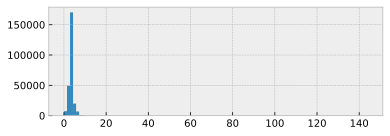

In [108]:
df.beds = df.beds.str.lower()
df.loc[df.beds.str.contains(' beds', na=False),
       'beds'] = df.beds.str.replace(' beds', '')
df.loc[df.beds.str.contains(' bd', na=False),
       'beds'] = df.beds.str.replace(' bd', '')
df.loc[df.beds.str.contains('bath', na=False), 'beds'] = np.nan
df.loc[df.beds.str.contains('sqft', na=False), 'beds'] = np.nan
df.loc[df.beds.str.contains('acre', na=False), 'beds'] = np.nan
df.loc[df.beds.str.contains('data', na=False), 'beds'] = np.nan
df.loc[df.beds.str.contains('bedrooms', na=False), 'beds'] = np.nan
df.loc[df.beds.str.contains('1-2', na=False), 'beds'] = 2
df.loc[df.beds == '--', 'beds'] = np.nan
# df.loc[df.beds=='bath', 'beds'] = 0
df.loc[df.beds == '', 'beds'] = np.nan
df.loc[df.beds.isnull(), 'beds'] = np.nan
df.loc[df.beds == ' ', 'beds'] = np.nan
df.beds = pd.to_numeric(df.beds)
df.beds.hist(bins=100)

In [109]:
# создадим DataFrame с медианными значениями beds сгруппированными по признаку propertyType
median_beds_df = pd.DataFrame(df.groupby(['propertyType'])['beds'].median()
                              .reset_index()
                              .rename(columns={'beds': 'beds_median'}))
# присоединим к нашим данным по признаку propertyType столбец c медианными значениями beds_median
df = pd.merge(df, median_beds_df, left_on=[
    'propertyType'], right_on=['propertyType'], how='left')
# Для случаев пропуска значений заменим значения столбца beds на медианные значения beds_median
df.loc[df.beds.isnull(), 'beds'] = df.loc[df.beds.isnull(), 'beds_median']

# Удалим вспомогательный столбец beds_median
df.drop('beds_median', axis=1, inplace=True)

# Проверим наличие пропусков
df.loc[df.beds.isnull()]

,status,private pool,propertyType,street,baths,homeFacts,fireplace,city,schools,sqft,...,priv_scl_mean_dist,priv_scl_mean_count,zip_population,zip_population_density,zip_land_area_in_sqmi,zip_water_area_in_sqmi,zip_housing_units,zip_occupied_housing_units,zip_median_home_value,zip_median_household_income


In [110]:
# # Заменим значения у типа дома 'lot/land' на 0
# df.loc[df.propertyType=='lot/land', 'beds']=0

## 5.14. state

In [111]:
df.state.value_counts()

FL    97634
TX    75702
CA    21215
NC    19869
NY    16929
TN    15238
WA    13408
OH    11824
IL     8353
NV     8239
GA     6550
CO     5556
PA     5366
MI     5120
DC     4310
IN     3267
AZ     2942
OR     2731
MA     1370
UT     1274
MD     1054
MO      831
VA      780
VT      778
NJ      426
WI      391
IA      242
ME      199
KY       89
OK       49
MS       40
SC       28
MT        7
AL        1
Name: state, dtype: int64

Признак - "штат". Прверим пропущенные значения:

In [112]:
df.state.isnull().sum()

0

Пропущеных значений нет

## 5.15. stories

In [113]:
df.stories.value_counts().head(10)

1.0    66096
2.0    53466
1      21935
2      16455
3.0    10576
0.0     6936
0       4072
3       3779
One     2909
9.0     2781
Name: stories, dtype: int64

Признак "количество этажей"

In [114]:
stories = df.stories
stories = stories.str.lower()
repl_dct = {'one': 1, 'two': 2, '3+': 3, '1 story': 1, '2 story': 2, 'condominium': 1, 'stories': 2, 'lot': 1,
            'three': 3, '1 level': 1, 'farm house': 1, 'split': 2, 'townhouse': 2, '1.5 story': 2, 'traditional': 1,
            '2.5 story': 3, 'acreage': 1, 'multi': 3, 'ranch': 2, 'tri-level': 3, 'high-rise': 9, 'mid-rise': 5,
            'detached': 1, '4 story': 4, '2 level': 2, ', 2': 2, '1.5 level': 2, 'commercial': 1, 'fourplex': 4,
            'manufactured': 1, 'mobile': 1, 'cabin': 2, 'victorian': 2, 'contemporary': 2, 'garden': 1, ', 1': 1,
            'cape': 1, 'modular': 2, 'bi-level': 2, 'site built': 1, 'total floors': 3, 'bungalow': 1, 'tri level': 3,
            'co-op': 2, 'farm': 1, 'duplex': 2, 'ground level': 1, 'sixplex': 6, 'quad level': 4, 'triplex': 3,
            'a frame': 1, 'tudor': 2, 'colonial': 1, 'hillside': 2, 'live': 1, 'apartments': 5, 'log': 1, 'loft': 2,
            'craftsman': 2, 'federal': 2, 'condo': 2, 'chalet': 1, 'double wide': 2, 'patio home': 2}

for repl in repl_dct:
    for_repl = repl
    to_repl = repl_dct[for_repl]
    stories[stories.str.contains(for_repl, na=False)] = to_repl

stories = pd.to_numeric(stories)
df.stories = stories
df.stories

0         NaN
1         2.0
2         1.0
3         3.0
4         NaN
         ... 
331807    NaN
331808    NaN
331809    1.0
331810    2.0
331811    NaN
Name: stories, Length: 331812, dtype: float64

In [115]:
# Проверим пропущенные значения
df[df.stories.isnull()]

,status,private pool,propertyType,street,baths,homeFacts,fireplace,city,schools,sqft,...,priv_scl_mean_dist,priv_scl_mean_count,zip_population,zip_population_density,zip_land_area_in_sqmi,zip_water_area_in_sqmi,zip_housing_units,zip_occupied_housing_units,zip_median_home_value,zip_median_household_income
0,active,NaN,houses,240 heather ln,3.5,"{'atAGlanceFacts': [{'factValue': '2019', 'fac...",1,southern pines,"[{'rating': ['4', '4', '7', 'NR', '4', '7', 'N...",2900.0,...,5.537500,8.0,13921.0,478.0,29.12,0.20,7608.0,6612.0,226500.0,47982.0
4,for rent,NaN,lots/land,1524 kiscoe st,NaN,"{'atAGlanceFacts': [{'factValue': '', 'factLab...",0,palm bay,"[{'rating': ['4/10', '5/10', '5/10'], 'data': ...",0.0,...,5.960000,1.0,10892.0,565.0,19.29,0.00,4230.0,3657.0,105300.0,46466.0
7,active,NaN,houses,11182 owl ave,2.0,"{'atAGlanceFacts': [{'factValue': '1970', 'fac...",0,mason city,"[{'rating': ['2', '2', '4', '7', '4', 'NR'], '...",3588.0,...,6.350000,6.0,29837.0,200.0,149.16,0.46,14147.0,13103.0,99800.0,42458.0
9,for sale,NaN,condos/coops,14205 roosevelt ave #512,2.0,"{'atAGlanceFacts': [{'factValue': '1965', 'fac...",0,flushing,"[{'rating': ['2/10', '8/10', '10/10'], 'data':...",1300.0,...,0.300000,1.0,54878.0,25324.0,2.17,0.03,22201.0,20120.0,380600.0,46566.0
14,new,NaN,houses,930 52nd st,NaN,"{'atAGlanceFacts': [{'factValue': '1905', 'fac...",0,brooklyn,"[{'rating': ['8', '8', '3'], 'data': {'Distanc...",2001.0,...,0.200000,1.0,92221.0,62225.0,1.48,0.00,28693.0,26177.0,726700.0,34316.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
331805,active,NaN,houses,3531 oak creek cir,3.0,"{'atAGlanceFacts': [{'factValue': '1955', 'fac...",1,dallas,"[{'rating': ['4', '4', '2', '10'], 'data': {'D...",2108.0,...,1.766667,3.0,55029.0,4828.0,11.40,0.01,17838.0,16304.0,86200.0,37720.0
331806,active,NaN,houses,1210 robbins pt,3.0,"{'atAGlanceFacts': [{'factValue': '2019', 'fac...",0,san antonio,"[{'rating': ['3', '5', '3'], 'data': {'Distanc...",1217.0,...,1.500000,2.0,56511.0,1701.0,33.22,0.11,18749.0,17691.0,114700.0,59785.0
331807,active,NaN,townhomes,3811 throckmorton st,3.0,"{'atAGlanceFacts': [{'factValue': '2015', 'fac...",1,dallas,"[{'rating': ['5', '5', '2', '10'], 'data': {'D...",2785.0,...,0.750000,2.0,22124.0,10108.0,2.19,0.00,15075.0,12384.0,247400.0,59650.0
331808,active,NaN,houses,235 emerson st nw #104,3.0,"{'atAGlanceFacts': [{'factValue': '1929', 'fac...",0,washington,"[{'rating': ['7', 'NR', '8', 'NR', '3'], 'data...",700.0,...,0.250000,2.0,58536.0,12002.0,4.88,0.04,25082.0,23035.0,376900.0,54488.0


In [116]:
# Заменим пропущенные значения на медианные
# создадим DataFrame с медианными значениями этажности дома сгруппированными по признаку propertyType
median_stories_df = pd.DataFrame(df.groupby(['propertyType'])['stories'].median()
                                 .reset_index()
                                 .rename(columns={'stories': 'stories_median'}))
# присоединим к нашим данным по признаку propertyType столбец c медианными значениями stories_median
df = pd.merge(df, median_stories_df, left_on=[
    'propertyType'], right_on=['propertyType'], how='left')

# Для случаев пропуска значений заменим значения столбца stories на медианные значения stories_median
df.loc[df.stories.isnull(), 'stories'] = df.loc[df.stories.isnull(),
                                                'stories_median']

# Удалим вспомогательный столбец sqft_median
df.drop('stories_median', axis=1, inplace=True)

# Проверим наличие пропусков
df.loc[df.stories.isnull()]

,status,private pool,propertyType,street,baths,homeFacts,fireplace,city,schools,sqft,...,priv_scl_mean_dist,priv_scl_mean_count,zip_population,zip_population_density,zip_land_area_in_sqmi,zip_water_area_in_sqmi,zip_housing_units,zip_occupied_housing_units,zip_median_home_value,zip_median_household_income


## 5.16 mls-id и MlsId

In [117]:
# Посмотрим на значения mls-id
df['mls-id'].value_counts()

No MLS#       3
No            3
19-5064       2
201906177     2
20193103      2
             ..
T3157540      1
DW19172763    1
7269527       1
201950283     1
201949712     1
Name: mls-id, Length: 24442, dtype: int64

Вероятно это признак уникального значения

In [118]:
# Проверим количество пропущенных значений
df['mls-id'].isnull().sum()

307336

Количество пропущенных значений велико. Этот признак- кандидат на удаление

In [119]:
# Посмотрим на значения MlsId
df.MlsId.value_counts()

NO MLS                        24
No MLS #                      16
 A, Houston, TX 77008         13
 1, South Boston, MA 02127     9
No                             9
                              ..
3265492                        1
567844                         1
2107144                        1
B1231236                       1
3562666                        1
Name: MlsId, Length: 212083, dtype: int64

In [120]:
# Проверим количество пропущенных значений
df['MlsId'].isnull().sum()

62708

In [121]:
df[df['MlsId'].isnull()].head(3)

,status,private pool,propertyType,street,baths,homeFacts,fireplace,city,schools,sqft,...,priv_scl_mean_dist,priv_scl_mean_count,zip_population,zip_population_density,zip_land_area_in_sqmi,zip_water_area_in_sqmi,zip_housing_units,zip_occupied_housing_units,zip_median_home_value,zip_median_household_income
12,new,NaN,houses,1538 umpqua dr,2.0,"{'atAGlanceFacts': [{'factValue': '2019', 'fac...",0,eugene,"[{'rating': ['7/10', '7/10', '8/10'], 'data': ...",1820.0,...,1.1,2.0,40521.0,4419.0,9.17,0.02,20211.0,19068.0,269200.0,31080.0
18,for sale,NaN,houses,5930 e avenue t2,2.0,"{'atAGlanceFacts': [{'factValue': '1989', 'fac...",0,palmdale,"[{'rating': ['3/10', '5/10'], 'data': {'Distan...",1731.0,...,2.9,1.0,38158.0,787.0,48.50,0.25,10422.0,9690.0,159600.0,56163.0
23,for sale,NaN,condos/coops,430 sterling pl #1a,2.0,"{'atAGlanceFacts': [{'factValue': '1910', 'fac...",0,brooklyn,"[{'rating': ['6/10'], 'data': {'Distance': ['0...",935.0,...,35.0,0.0,49262.0,44555.0,1.11,0.00,24525.0,22648.0,656800.0,65315.0


MLS – Multi Listing Service – это информационно-правовая система взаимодействия всех участников на рынке недвижимости. МЛС позволяет одним агентствам, заинтересованным в скорейшей продаже/аренде своих эксклюзивных объектов недвижимости и готовым поделиться частью своей комиссии, привлечь другие агентства к сотрудничеству.

Это признаки идинтификатора включения в единую базу данных участников на рынке недвижимости США

In [122]:
# Проверим случаи пересечения признаков "mls-id" и "MlsId"
df[(df['mls-id'].notnull()) & (df['MlsId'].notnull())]

,status,private pool,propertyType,street,baths,homeFacts,fireplace,city,schools,sqft,...,priv_scl_mean_dist,priv_scl_mean_count,zip_population,zip_population_density,zip_land_area_in_sqmi,zip_water_area_in_sqmi,zip_housing_units,zip_occupied_housing_units,zip_median_home_value,zip_median_household_income


Пересечений нет

In [123]:
# df.drop(index=df[(df['mls-id'].notnull())&(df['MlsId'].notnull())].index, inplace=True)
# df = df.reset_index(drop=True)

Вместо признаков "mls-id" и "MlsId" создадим один признак MLS у которого будет значение "1", если в "mls-id" или "MlsId" будут значения отличные от '0', 'No MLS'

In [124]:
df.loc[df['mls-id'].str.contains('No', na=False), 'mls-id'] = None
df.loc[df['MlsId'].str.contains('NO MLS', na=False), 'MlsId'] = None

In [125]:
MLS = df['mls-id']
MLS.loc[(df['mls-id'].notnull()) | (df['MlsId'].notnull())] = 1
MLS.loc[(df['mls-id'].isnull()) & (df['MlsId'].isnull())] = 0
MLS

c:\users\пользователь\appdata\local\programs\python\python38\lib\site-packages\pandas\core\indexing.py:670: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  iloc._setitem_with_indexer(indexer, value)


0         1
1         1
2         1
3         1
4         1
         ..
331807    1
331808    1
331809    1
331810    1
331811    1
Name: mls-id, Length: 331812, dtype: object

In [126]:
# Проверим количество значений признака равных 1
len(MLS[MLS == 1])

293549

In [127]:
# Проверим количество значений признака равных 0
len(MLS[MLS == 0])

38263

In [128]:
df['MLS'] = MLS

In [129]:
df[(df['mls-id'] == '0') & (df['MlsId'] == '0')]

,status,private pool,propertyType,street,baths,homeFacts,fireplace,city,schools,sqft,...,priv_scl_mean_count,zip_population,zip_population_density,zip_land_area_in_sqmi,zip_water_area_in_sqmi,zip_housing_units,zip_occupied_housing_units,zip_median_home_value,zip_median_household_income,MLS


In [130]:
df.MLS

0         1
1         1
2         1
3         1
4         1
         ..
331807    1
331808    1
331809    1
331810    1
331811    1
Name: MLS, Length: 331812, dtype: object

## 5.17. Year built

In [131]:
df['Year built']

0         2019
1         2019
2         1961
3         2006
4             
          ... 
331807    2015
331808    1929
331809    2001
331810    1970
331811    2008
Name: Year built, Length: 331812, dtype: object

Признак - 'год постройки'. Посмотрим на значение цены при отсутствующих значениях в столбце 'год постройки'

<AxesSubplot:>

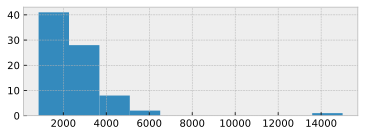

In [132]:
df[df['Year built'].isnull()].target.hist()

Судя по цене это жилье скорее всего не на продажу, а для съема. посмотрим на его статус

In [133]:
df[df['Year built'].isnull()].head(4)

,status,private pool,propertyType,street,baths,homeFacts,fireplace,city,schools,sqft,...,priv_scl_mean_count,zip_population,zip_population_density,zip_land_area_in_sqmi,zip_water_area_in_sqmi,zip_housing_units,zip_occupied_housing_units,zip_median_home_value,zip_median_household_income,MLS
1115,for rent,NaN,multi-family,19355 turnberry way apt 2b,NaN,"{'atAGlanceFacts': [{'factValue': None, 'factL...",0,aventura,"[{'rating': ['7/10', '5/10'], 'data': {'Distan...",2184.0,...,1.0,30840.0,9051.0,3.41,0.55,20316.0,14197.0,328300.0,68317.0,0
7651,for rent,NaN,multi-family,8516 nesbit ave n apt b,NaN,"{'atAGlanceFacts': [{'factValue': None, 'factL...",0,seattle,"[{'rating': ['7/10', 'NA'], 'data': {'Distance...",2184.0,...,1.0,45911.0,9905.0,4.64,0.66,24128.0,22724.0,478200.0,75763.0,0
12873,for rent,NaN,houses,3110 4th street cir,NaN,"{'atAGlanceFacts': [{'factValue': None, 'factL...",0,jacksonville,"[{'rating': ['2/10', '2/10', '3/10'], 'data': ...",2001.0,...,2.0,13570.0,1096.0,12.39,0.03,5992.0,4829.0,75800.0,26457.0,0
18065,for rent,NaN,other style,909 5th ave unit 2302,NaN,"{'atAGlanceFacts': [{'factValue': None, 'factL...",0,seattle,"[{'rating': ['2/10', '5/10', '7/10'], 'data': ...",1700.0,...,2.0,141.0,39846.0,0.00,0.00,126.0,97.0,NaN,73833.0,0


В некоторых строках статус не указан. Заполним его как "for rent"

In [134]:
df.loc[df['Year built'].isnull(), 'status'] = 'for rent'

In [135]:
# Проверим изменения
df.loc[df['Year built'].isnull(), 'status'].head(4)

1115     for rent
7651     for rent
12873    for rent
18065    for rent
Name: status, dtype: object

<AxesSubplot:>

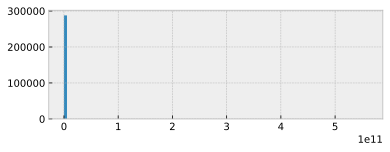

In [136]:
# Изменим тип признака 'Year built' на числовой. Пропущенные значения заменим на 2100
df.loc[df['Year built'].isnull(), 'Year built'] = 2100
df.loc[df['Year built'] == 'No Data', 'Year built'] = 2100
df['Year built'] = pd.to_numeric(df['Year built'])
df['Year built'].hist(bins=100)

Присутствуют выбросы. Посмотрим на них

In [137]:
df[df['Year built'] > 2100]

,status,private pool,propertyType,street,baths,homeFacts,fireplace,city,schools,sqft,...,priv_scl_mean_count,zip_population,zip_population_density,zip_land_area_in_sqmi,zip_water_area_in_sqmi,zip_housing_units,zip_occupied_housing_units,zip_median_home_value,zip_median_household_income,MLS
66586,active,NaN,townhomes,12522 15th ave ne,2.5,{'atAGlanceFacts': [{'factValue': '55999064999...,0,seattle,"[{'rating': ['5', '6', '7', '6', '7', 'NR', 'N...",1486.0,...,7.0,37081.0,6879.0,5.39,1.54,18677.0,17169.0,372000.0,53044.0,1
303082,active,NaN,townhomes,12522 15th ave ne,2.5,{'atAGlanceFacts': [{'factValue': '55999064999...,0,seattle,"[{'rating': ['5', '6', '7', '6', '7', 'NR', 'N...",1233.0,...,7.0,37081.0,6879.0,5.39,1.54,18677.0,17169.0,372000.0,53044.0,1


In [138]:
# Удалим значения с выбросами
df.drop(df[df['Year built'] > 2100].index, inplace=True)
df = df.reset_index(drop=True)

<AxesSubplot:>

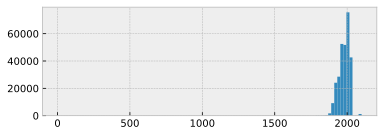

In [139]:
df['Year built'].hist(bins=100)

In [140]:
# Посмотрим на дома с годом постройки меньше 1800
df[df['Year built'] < 1800].head(3)

,status,private pool,propertyType,street,baths,homeFacts,fireplace,city,schools,sqft,...,priv_scl_mean_count,zip_population,zip_population_density,zip_land_area_in_sqmi,zip_water_area_in_sqmi,zip_housing_units,zip_occupied_housing_units,zip_median_home_value,zip_median_household_income,MLS
1761,for sale,Yes,houses,2504 main st,10.0,"{'atAGlanceFacts': [{'factValue': '1740', 'fac...",0,barnstable,"[{'rating': ['NA', '4/10', '5/10'], 'data': {'...",2001.0,...,2.0,1850.0,461.0,4.01,2.02,1142.0,823.0,486500.0,61250.0,1
2058,for sale,NaN,lots/land,12517 se petrovitsky rd,NaN,"{'atAGlanceFacts': [{'factValue': '1700', 'fac...",0,renton,"[{'rating': ['5/10', '5/10', '3/10'], 'data': ...",3380.0,...,1.0,41938.0,2215.0,18.93,0.83,16120.0,15395.0,302200.0,77780.0,1
19798,for sale,NaN,houses,1810 lincoln st,2.0,"{'atAGlanceFacts': [{'factValue': '1799', 'fac...",0,laredo,"[{'rating': [], 'data': {'Distance': [], 'Grad...",2348.0,...,0.0,42083.0,6680.0,6.30,0.13,13508.0,11955.0,73800.0,23199.0,0


In [141]:
# Удалим значения с годом постройки менее 1800
df.drop(df[df['Year built'] < 1800].index, inplace=True)
df = df.reset_index(drop=True)

Созданим новый признак "возраст дома" (age_house). Передадим в него соответствующие значения из 'Year built'

<AxesSubplot:>

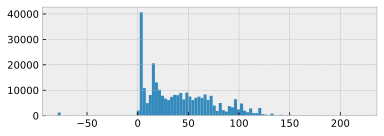

In [142]:
df['age_house'] = 2021 - df['Year built']
df['age_house'].hist(bins=100)

## 5.18. Remodeled year

In [143]:
df['Remodeled year'].value_counts()

        175969
2006      4926
2005      4283
2007      3819
2008      3300
         ...  
1853         1
1846         1
1888         1
1862         1
1870         1
Name: Remodeled year, Length: 150, dtype: int64

Признак - "год реконструкции дома". Посмотрим на пропуски

In [144]:
df['Remodeled year'].isnull().sum()

22015

<AxesSubplot:>

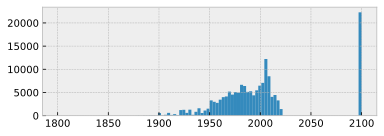

In [145]:
# Изменим тип признака 'Remodeled year' на числовой. Пропущенные и нулевые значения заменим на 2100
df.loc[df['Remodeled year'].isnull(), 'Remodeled year'] = 2100
df.loc[df['Remodeled year'] == '0', 'Remodeled year'] = 2100
# df.loc[df['Remodeled year']=='No Data', 'Remodeled year'] = 2100
df['Remodeled year'] = pd.to_numeric(df['Remodeled year'])
df['Remodeled year'].hist(bins=100)

In [146]:
df[df['Remodeled year'] < 1800]

,status,private pool,propertyType,street,baths,homeFacts,fireplace,city,schools,sqft,...,zip_population,zip_population_density,zip_land_area_in_sqmi,zip_water_area_in_sqmi,zip_housing_units,zip_occupied_housing_units,zip_median_home_value,zip_median_household_income,MLS,age_house


In [147]:
# Удалим значения с годом реконструкции менее 1800
df.drop(df[df['Remodeled year'] < 1800].index, inplace=True)
df = df.reset_index(drop=True)

Созданим новый признак "возраст реконструкции" (age_remodeled). Передадим в него соответствующие значения из 'Remodeled year'

<AxesSubplot:>

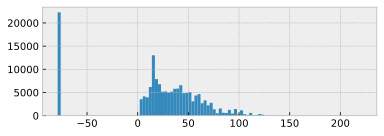

In [148]:
df['age_remodeled'] = 2021 - df['Remodeled year']
df['age_remodeled'].hist(bins=100)

## 5.19. Heating

In [149]:
df.Heating.value_counts()

                                       81402
Forced Air                             80396
Forced air                             49573
Other                                  28545
Electric                                9402
                                       ...  
Gas Hot Air/Furnace, Gas Steam Heat        1
furnace is 1.5 years old                   1
Central-Central Hot Water                  1
lower level-Electric                       1
2nd floor-Electric                         1
Name: Heating, Length: 1880, dtype: int64

Признак "отопление". Очень много вариантов - 1887! Преобразуем все варианты в следующие категории отопления:
- central
- forced air
- electric
- gas
- other
- unknown

<AxesSubplot:>

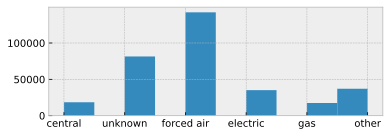

In [150]:
Heating = df.Heating
Heating = Heating.str.lower()
repl_dct = {'gas': 'gas', 'air': 'forced air', 'electric': 'electric', 'space heater': 'electric', 'propane': 'gas',
            'no data': 'other', 'central air': 'forced air', 'wall': 'electric', 'central': 'central',
            'refrigeration': 'electric', 'heat pump': 'heat pump', 'window units': 'electric', 'baseboard': 'electric',
            'hot air': 'forced air', 'oil': 'gas', 'heating system': 'central', 'radiator': 'central', 'hot water': 'central',
            'has heating': 'central', 'forced warm air': 'forced air', 'forcedair': 'forced air', 'radiant': 'electric',
            'steam': 'central', 'multizone': 'electric', 'window': 'electric', 'other': 'other', 'floor furnace': 'electric',
            'yes': 'central', 'zoned': 'electric', 'heat': 'central', 'no cooling/vent': '', 'stove': 'electric',
            'solar': 'other', 'contact': 'other', 'gravity': 'other', 'combination': 'electric', 'dual': 'other',
            'wood': 'other', 'no heat': 'other', 'basement': 'gas', 'garage': 'gas', 'tankless': 'other',
            'unit': 'other', 'reverse': 'other', 'fireplace': 'other', 'hvac': 'other', 'ceiling': 'forced air', 'floor': 'other',
            'star': 'other', 'closet': 'other', 'room': 'other', 'lower': 'other', 'pellet': 'other', '1': 'other',
            'thermo': 'other', '2': 'other', '5': 'other', 'monitor': 'other', 'common': 'other', 'fans': 'other',
            'elec': 'electric', 'mixed': 'other', 'split': 'other', 'high': 'other', '3': 'other', 'cooling': 'other',
            'apply': 'other', 'built': 'other', 'multi': 'other', 'demand': 'other', 'summer': 'other', 'furnace': 'other'}

for repl in repl_dct:
    for_repl = repl
    to_repl = repl_dct[for_repl]
    Heating[Heating.str.contains(for_repl, na=False)] = to_repl
Heating.loc[Heating == ''] = 'unknown'
Heating.loc[Heating.isnull()] = 'unknown'
Heating.hist()

In [151]:
df.Heating = Heating

## 5.20. Cooling

In [152]:
df.Cooling.value_counts()

Central                                     152872
                                             96935
No Data                                      10140
Central Air                                   9945
Has Cooling                                   6915
                                             ...  
1 Unit, Baseboard - Hotwater, Multi-Zone         1
Baseboard Heat, Hot Water, Radiator Heat         1
Central Gas, Heat Pump, Zoned                    1
Propane, Space Heater                            1
Room Refrig Air                                  1
Name: Cooling, Length: 1323, dtype: int64

Признак - "охлаждение". Очень много вариантов - 1324. Преобразуем все варианты в следующие категории охлаждения:
- central
- has cooling
- ceiling fan
- other
- no cooling
- unknown

<AxesSubplot:>

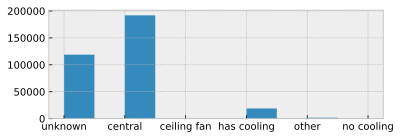

In [153]:
Cooling = df.Cooling
Cooling = Cooling.str.lower()
# repl_dct ={}

repl_dct = {'central': 'central', 'refrigeration': 'has cooling', 'wall': 'has cooling', 'evaporative': 'has cooling',
            'cooling system': 'has cooling', 'heat': 'unknown', 'ceiling fan': 'ceiling fan', 'window unit': 'unknown',
            'conditioning unit': 'has cooling', 'yes': 'has cooling', 'no cooling': 'no cooling', 'no data': 'unknown',
            'electric': 'has cooling', 'conditioning': 'has cooling', 'a/c': 'has cooling', 'cenrtal ac': 'central',
            'zoned': 'has cooling', 'other cooling': 'other'}

for repl in repl_dct:
    for_repl = repl
    to_repl = repl_dct[for_repl]
    Cooling[Cooling.str.contains(for_repl, na=False)] = to_repl
Cooling.loc[Cooling == ''] = 'unknown'
Cooling.loc[Cooling.isnull()] = 'unknown'

is_cooling_lst = ['central', 'unknown', 'has cooling',
                  'other', 'ceiling fan', 'no cooling']
Cooling[~Cooling.isin(is_cooling_lst)] = 'unknown'
Cooling.hist()

In [154]:
# проверим пропущенные значения
Cooling.isnull().sum()

0

In [155]:
df.Cooling = Cooling

## 5.21. Parking

In [156]:
df.Parking.value_counts()

                                                                                                                                           136867
Attached Garage                                                                                                                             68256
2 spaces                                                                                                                                    27454
1 space                                                                                                                                     13992
Detached Garage                                                                                                                             12873
                                                                                                                                            ...  
Activities Available, Clubhouse, Game Room, Hot Tub Pool, Laundry Facility, Swim Pool-Inground                              

Признак - "парковка". Создадим функцию для извлечения признаков из этого поля:
- attached_garage - пристроенный гараж
- detached_garage - отделенный гараж
- carport - Навес
- parking_space - парковочное место

Признаки числовые. Если признак равен 0, то означает что он отсутствует, если значение более 0, то это количество машиномест в этом признаке

In [157]:
Parking = df.Parking
Parking = Parking.str.lower()


def parking_features(text):
    '''Функция принимает на вход значение ячейки Parking и выделяет признаки:
    - attached_garage
    - detached_garage
    - carport
    - parking_space
    Возможные значения возвращаемых признаков:
    0 - признак отсутствует
    > 0 - числовое значение признака'''
#     print(text)
    if 'attached garage' in text:
        try:
            attached_garage = re.findall(
                "attached garage, garage - ([\+d]+?) car", text, flags=0)[0][1]
        except:
            #             print(text)
            attached_garage = 1
    else:
        attached_garage = 0
    if 'detached garage' in text:
        try:
            detached_garage = re.findall(
                "detached garage, garage - ([\+d]+?) car", text, flags=0)[0][1]
        except:
            #             print(text)
            detached_garage = 1
    else:
        detached_garage = 0
    if 'carport' in text:
        carport = 1
    else:
        carport = 0

    try:
        parking_space = re.findall("(\d+)( space)", text, flags=0)[0][0]
    except:
        try:
            parking_space = re.findall("(\d+)", text, flags=0)[0][0]
        except:
            #             print(text)
            if 'off street' in text:
                parking_space = 1
            else:
                parking_space = 0

    res = {'attached_garage': attached_garage, 'detached_garage': detached_garage, 'carport': carport,
           'parking_space': parking_space}
#     print(res)
    return res


Parking = Parking.fillna('')
Parking_dct = Parking.apply(parking_features)
Parking = pd.DataFrame.from_records(Parking_dct)
Parking

,attached_garage,detached_garage,carport,parking_space
0,0,0,0,0
1,0,0,0,0
2,1,0,0,0
3,0,1,0,0
4,0,0,0,0
...,...,...,...,...
331783,0,0,0,0
331784,0,0,0,0
331785,0,0,0,0
331786,0,0,0,0


In [158]:
# Присоединим полученые значения к датафрейму
df = pd.concat([df.reset_index(drop=True), Parking], axis=1)
df

,status,private pool,propertyType,street,baths,homeFacts,fireplace,city,schools,sqft,...,zip_occupied_housing_units,zip_median_home_value,zip_median_household_income,MLS,age_house,age_remodeled,attached_garage,detached_garage,carport,parking_space
0,active,NaN,houses,240 heather ln,3.5,"{'atAGlanceFacts': [{'factValue': '2019', 'fac...",1,southern pines,"[{'rating': ['4', '4', '7', 'NR', '4', '7', 'N...",2900.0,...,6612.0,226500.0,47982.0,1,2.0,NaN,0,0,0,0
1,for sale,NaN,houses,12911 e heroy ave,3.0,"{'atAGlanceFacts': [{'factValue': '2019', 'fac...",0,spokane valley,"[{'rating': ['4/10', 'None/10', '4/10'], 'data...",1947.0,...,10144.0,179000.0,45098.0,1,2.0,NaN,0,0,0,0
2,for sale,NaN,houses,2005 westridge rd,2.0,"{'atAGlanceFacts': [{'factValue': '1961', 'fac...",1,los angeles,"[{'rating': ['8/10', '4/10', '8/10'], 'data': ...",3000.0,...,16657.0,1000001.0,110854.0,1,60.0,54.0,1,0,0,0
3,for sale,NaN,houses,4311 livingston ave,8.0,"{'atAGlanceFacts': [{'factValue': '2006', 'fac...",1,dallas,"[{'rating': ['9/10', '9/10', '10/10', '9/10'],...",6457.0,...,9016.0,937100.0,108913.0,1,15.0,15.0,0,1,0,0
4,for rent,NaN,lots/land,1524 kiscoe st,NaN,"{'atAGlanceFacts': [{'factValue': '', 'factLab...",0,palm bay,"[{'rating': ['4/10', '5/10', '5/10'], 'data': ...",0.0,...,3657.0,105300.0,46466.0,1,NaN,NaN,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
331783,active,NaN,townhomes,3811 throckmorton st,3.0,"{'atAGlanceFacts': [{'factValue': '2015', 'fac...",1,dallas,"[{'rating': ['5', '5', '2', '10'], 'data': {'D...",2785.0,...,12384.0,247400.0,59650.0,1,6.0,6.0,0,0,0,0
331784,active,NaN,houses,235 emerson st nw #104,3.0,"{'atAGlanceFacts': [{'factValue': '1929', 'fac...",0,washington,"[{'rating': ['7', 'NR', '8', 'NR', '3'], 'data...",700.0,...,23035.0,376900.0,54488.0,1,92.0,NaN,0,0,0,0
331785,active,NaN,houses,5919 w harrow dr,3.0,"{'atAGlanceFacts': [{'factValue': '2001', 'fac...",1,houston,"[{'rating': ['5', '6', '6'], 'data': {'Distanc...",1597.0,...,31473.0,124300.0,62785.0,1,20.0,20.0,0,0,0,0
331786,active,NaN,townhomes,10578 high hollows dr #269,3.0,"{'atAGlanceFacts': [{'factValue': '1970', 'fac...",1,dallas,"[{'rating': ['6', '3', '4', '10'], 'data': {'D...",1709.0,...,12354.0,461900.0,68863.0,1,51.0,51.0,0,0,0,0


In [159]:
# Изменим значение на числовое
df[['attached_garage', 'detached_garage', 'carport', 'parking_space']] = \
    df[['attached_garage', 'detached_garage',
        'carport', 'parking_space']].astype(int)

<AxesSubplot:>

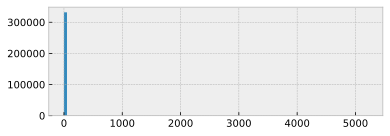

In [160]:
# Проверим распределение признака
df['parking_space'].hist(bins=100)

Имеются выбросы. Заменим значения выросов для некоторых категорий:

In [161]:
df.loc[(df['parking_space'] > 10) & (df['propertyType'] != 'townhouse')
       & (df['target'] < 1000000), 'parking_space'] = 2
df.loc[(df['parking_space'] > 10) & (df['propertyType'] == 'townhouse')
       & (df['target'] < 1000000), 'parking_space'] = 1

In [162]:
df.loc[(df['parking_space'] > 100)]

,status,private pool,propertyType,street,baths,homeFacts,fireplace,city,schools,sqft,...,zip_occupied_housing_units,zip_median_home_value,zip_median_household_income,MLS,age_house,age_remodeled,attached_garage,detached_garage,carport,parking_space
252765,unknown,NaN,condos/coops,3350 sw 27th ave apt 2103,3.0,"{'atAGlanceFacts': [{'factValue': '2002', 'fac...",0,miami,"[{'rating': ['10/10', '5/10'], 'data': {'Dista...",1831.0,...,13986.0,419800.0,55134.0,1,19.0,19.0,0,0,0,150


In [163]:
# удалим записи со значениями количества парковочных мест более 100
df.drop(df[df['parking_space'] > 100].index, inplace=True)

<AxesSubplot:>

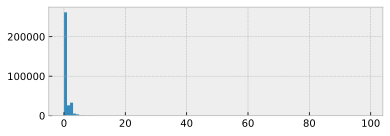

In [164]:
# Проверим распределение признака
df['parking_space'].hist(bins=100)

In [165]:
# Удалим признак Parking
df.drop('Parking', axis=1, inplace=True)

In [166]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 331787 entries, 0 to 331787
Data columns (total 52 columns):
 #   Column                       Non-Null Count   Dtype  
---  ------                       --------------   -----  
 0   status                       331787 non-null  object 
 1   private pool                 4012 non-null    object 
 2   propertyType                 331787 non-null  object 
 3   street                       331787 non-null  object 
 4   baths                        255809 non-null  float64
 5   homeFacts                    331787 non-null  object 
 6   fireplace                    331787 non-null  object 
 7   city                         331787 non-null  object 
 8   schools                      331787 non-null  object 
 9   sqft                         331787 non-null  float64
 10  zipcode                      331787 non-null  object 
 11  beds                         331787 non-null  float64
 12  state                        331787 non-null  object 
 13 

## 5.22. lotsize

In [167]:
df.lotsize.value_counts()

                 31457
—                10108
No Data           5243
-- sqft lot       3730
0.26 acres        2410
                 ...  
17379                1
61659 sqft           1
3,083 Sq. Ft.        1
235268               1
585                  1
Name: lotsize, Length: 34924, dtype: int64

Признак 'размер участка'. Преобразуем в числовое значение. Заметим, что значение может быть выражено в квадратных футах (по умолчанию) или в акрах. Приведем все значения в квадратные футы

In [168]:
def find_num(value):
    # функция принимает на вход значение ячейки lotsize и разделяет ее на числовые и текстовые признаки
    # Извлечем числовое значение
    try:
        numvalues = re.findall("^[0-9]*[.,][0-9]+|^[0-9]*", value, flags=0)[0]
    except:
        numvalues = 0
    # Извлечем текстовое значение
    try:
        txtvalues = re.findall("\D+", value, flags=0)
    except:
        txtvalues = ''
    if txtvalues != '':
        txtvalues = ''.join(txtvalues)
    res = {'numvalues': numvalues, 'txtvalues': txtvalues}
    return res


# Приведем к нижнему регистру
lotsize = df.lotsize.str.lower()
# Ивлечем числовые и текстовые признаки в словарь
lotsize_dct = lotsize.apply(find_num)
# Преобразуем словарь в датафрейм
lotsize_df = pd.DataFrame.from_records(lotsize_dct, index=df.index)

# Определим по текстовому значению в каких единицах записано значения в квадратных футах или акрах
lotsize_df.loc[lotsize_df.txtvalues.str.contains(
    'sq', na=False), 'txtvalues'] = 'sqft'
lotsize_df.loc[lotsize_df.txtvalues.str.contains(
    'acre', na=False), 'txtvalues'] = 'acres'
lotsize_df.loc[(lotsize_df.txtvalues.isnull()) |
               (lotsize_df.txtvalues == '') |
               (lotsize_df.txtvalues == '—') |
               (lotsize_df.txtvalues == 'no data') |
               (lotsize_df.txtvalues == '-'), 'txtvalues'] = 'sqft'

lotsize_df.numvalues = pd.to_numeric(
    lotsize_df.numvalues.str.replace(',', '')).fillna(0)

# Если значение записано в акрах приведем числовое значение в квадратные футы
lotsize_df.loc[lotsize_df.txtvalues == 'acres', 'numvalues'] = \
    np.round_(lotsize_df.loc[lotsize_df.txtvalues ==
                             'acres', 'numvalues']*43560.04)
df.lotsize = lotsize_df.numvalues
df.lotsize

0             0.0
1          5828.0
2          8626.0
3          8220.0
4         10019.0
           ...   
331783     3049.0
331784        0.0
331785     5060.0
331786        0.0
331787        0.0
Name: lotsize, Length: 331787, dtype: float64

<AxesSubplot:>

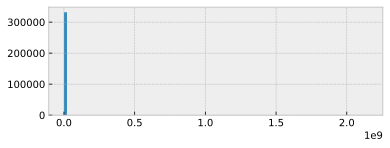

In [169]:
# Посмотрим на распределение признака
df.lotsize.hist(bins=100)

Имеются большие значения. Посмотрим на них

In [170]:
df[df.lotsize > 1000000]

,status,private pool,propertyType,street,baths,homeFacts,fireplace,city,schools,sqft,...,zip_occupied_housing_units,zip_median_home_value,zip_median_household_income,MLS,age_house,age_remodeled,attached_garage,detached_garage,carport,parking_space
62,for sale,NaN,houses,1397 roberts rd,4.0,"{'atAGlanceFacts': [{'factValue': '1994', 'fac...",1,saint johns,"[{'rating': ['10/10', '8/10', '9/10'], 'data':...",3928.0,...,12441.0,281000.0,96166.0,1,27.0,22.0,1,1,1,0
538,active,NaN,lots/land,1312 jacob dr,NaN,"{'atAGlanceFacts': [{'factValue': '', 'factLab...",0,soddy daisy,"[{'rating': ['8', '8', '6', '6', '6', '2', 'NR...",0.0,...,10389.0,154900.0,54713.0,1,NaN,NaN,0,0,0,0
642,unknown,NaN,houses,6751 perry st,2.0,"{'atAGlanceFacts': [{'factValue': '1952', 'fac...",0,jacksonville,"[{'rating': ['4/10', '2/10', '3/10'], 'data': ...",1679.0,...,12260.0,92400.0,32925.0,1,69.0,69.0,1,0,0,0
854,active,NaN,houses,19544 26 mile rd,2.5,"{'atAGlanceFacts': [{'factValue': '1900', 'fac...",1,albion,"[{'rating': ['5', '5', '5'], 'data': {'Distanc...",2364.0,...,5102.0,79500.0,32632.0,1,121.0,NaN,0,0,0,0
976,for sale,NaN,houses,430 brown rd,1.5,"{'atAGlanceFacts': [{'factValue': '1955', 'fac...",0,cleveland,"[{'rating': ['5', '4', '2', 'NR', 'NR', 'NR'],...",2001.0,...,4704.0,85700.0,48250.0,1,66.0,NaN,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
321861,for sale,NaN,lots/land,2239 ingram rd,2.0,"{'atAGlanceFacts': [{'factValue': '2006', 'fac...",1,whites creek,"[{'rating': ['2/10', '1/10', 'None/10'], 'data...",3001.0,...,1256.0,171400.0,52589.0,1,15.0,15.0,1,0,0,0
322062,for sale,NaN,lots/land,1 montwood dr,NaN,"{'atAGlanceFacts': [{'factValue': '', 'factLab...",0,el paso,"[{'rating': ['5/10', '7/10', '6/10'], 'data': ...",0.0,...,13243.0,111800.0,48251.0,1,NaN,NaN,0,0,0,0
322202,for sale,NaN,lots/land,100 highway 100,NaN,"{'atAGlanceFacts': [{'factValue': '', 'factLab...",0,los fresnos,"[{'rating': ['8/10', '4/10', '6/10', '7/10'], ...",0.0,...,4276.0,88200.0,39361.0,1,NaN,NaN,0,0,0,0
322440,active,NaN,houses,926 county road 2189,NaN,"{'atAGlanceFacts': [{'factValue': '1991', 'fac...",1,cleveland,"[{'rating': ['6', '7', '4', '6'], 'data': {'Di...",2986.0,...,7016.0,79200.0,46936.0,1,30.0,NaN,0,0,0,0


Это не выбросы. Имеются дома с большими участками или просто продается земля большой площади

In [171]:
# # Удалим эти значения
# df.drop(df[df.lotsize>1000000].index, inplace=True)

## 5.23. Price/sqft

In [172]:
df['Price/sqft'].value_counts()

               4479
No Data        1010
$1/sqft         974
No Info         916
$125/sqft       793
               ... 
$1,424            1
$1,674            1
$1,332            1
$3,050/sqft       1
$1,146            1
Name: Price/sqft, Length: 4696, dtype: int64

Признак 'стоимость квадратного фута площади'. 

In [173]:
df['Price/sqft'] = df['Price/sqft'].str.replace(r'\D+', '', regex=True)
df['Price/sqft'] = pd.to_numeric(df['Price/sqft'])
df['Price/sqft'] = df['Price/sqft'].fillna(0)
df['Price/sqft']

0         144.0
1         159.0
2         965.0
3         371.0
4           0.0
          ...  
331783    269.0
331784    339.0
331785    116.0
331786     96.0
331787    368.0
Name: Price/sqft, Length: 331787, dtype: float64

<AxesSubplot:>

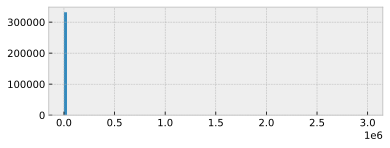

In [174]:
df['Price/sqft'].hist(bins=100)

Этот признак - кандидат на удаление, так как он связан с целевой переменной target

## Дупликаты

In [175]:
# Проверим количество дупликатов в данных
df[df.duplicated(subset=['city', 'street', 'target'],
                 keep=False)].sort_values(by=['street'])

,status,private pool,propertyType,street,baths,homeFacts,fireplace,city,schools,sqft,...,zip_occupied_housing_units,zip_median_home_value,zip_median_household_income,MLS,age_house,age_remodeled,attached_garage,detached_garage,carport,parking_space
117355,for sale,NaN,multi-family,1 arthur st,1.0,"{'atAGlanceFacts': [{'factValue': '1970', 'fac...",0,binghamton,"[{'rating': ['3/10', '3/10'], 'data': {'Distan...",3362.0,...,11956.0,101100.0,34520.0,1,51.0,NaN,0,0,0,0
310170,for sale,NaN,multi-family,1 arthur st,NaN,"{'atAGlanceFacts': [{'factValue': '1970', 'fac...",0,binghamton,"[{'rating': ['3/10', '3/10', '3/10'], 'data': ...",3362.0,...,11956.0,101100.0,34520.0,1,51.0,NaN,0,0,0,0
307896,for sale,NaN,houses,1 bay st,3.0,"{'atAGlanceFacts': [{'factValue': '1830', 'fac...",1,boston,"[{'rating': ['5/10', '3/10'], 'data': {'Distan...",1440.0,...,11026.0,807600.0,87653.0,1,191.0,4.0,0,0,0,2
54406,for sale,NaN,houses,1 bay st,3.0,"{'atAGlanceFacts': [{'factValue': '1830', 'fac...",1,boston,"[{'rating': [], 'data': {'Distance': [], 'Grad...",1440.0,...,11026.0,807600.0,87653.0,1,191.0,4.0,0,0,0,1
92965,for sale,NaN,houses,1 blaketon ct,2.0,"{'atAGlanceFacts': [{'factValue': '1980', 'fac...",1,palm coast,"[{'rating': ['5/10', '7/10', '6/10'], 'data': ...",1920.0,...,16012.0,198900.0,51153.0,1,41.0,36.0,1,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
278680,active,NaN,lots/land,wilson way lot 1,NaN,"{'atAGlanceFacts': [{'factValue': '', 'factLab...",0,cleveland,"[{'rating': ['6', '5', '8', '7', '5', '7', 'NR...",0.0,...,12166.0,171900.0,51305.0,1,NaN,NaN,0,0,0,0
213363,for sale,NaN,lots/land,winnabow rd,NaN,"{'atAGlanceFacts': [{'factValue': '', 'factLab...",0,winston salem,"[{'rating': ['3/10', '2/10', '3/10'], 'data': ...",0.0,...,14803.0,96900.0,30308.0,1,NaN,NaN,0,0,0,0
110063,active,NaN,lots/land,winnabow rd,NaN,"{'atAGlanceFacts': [{'factValue': '', 'factLab...",0,winston salem,"[{'rating': ['2', '3', '3', '5', '1', '8', 'NR...",0.0,...,14803.0,96900.0,30308.0,1,NaN,NaN,0,0,0,0
124084,active,NaN,lots/land,woodberry,NaN,"{'atAGlanceFacts': [{'factValue': '', 'factLab...",0,queen city,"[{'rating': [], 'data': {'Distance': [], 'Grad...",0.0,...,1456.0,73700.0,36026.0,1,NaN,NaN,0,0,0,0


In [176]:
# Удалим дупликаты
df.drop_duplicates(subset=['city', 'street', 'target'],
                   keep='first', inplace=True)

## 6. Промежуточные итоги
На начало анализа датасета у нас не было описания полей и данных в них. После Анализа датасета мы определили и создали следующие признаки:
1. Target – целевая переменная. Преобразовали в числовое значение. Удалили записи со значениями более 3000000

2. Status - статус жилья. Всего было вариантов  - 159. Мы преобразовали все возможные варианты к основным вариантам:
- 1) 'for sale' - на продажу;
- 2) 'active' - активно используется;
- 3) 'unknown' - значение пропущено или непонятно;
- 4) 'new' - новое жилье;
- 5) 'for rent' - сдается в аренду

3. private pool и PrivatePool – наличие частного бассейна. Объединили оба признака в один PrivatePool, привели его к числовому значению

4. propertyType - Признак 'тип недвижимости'. Всего было вариантов – 1253. Мы преобразовали значения в следующие категории типа недвижимости:
-	1) houses - различные типы домов;
-	2) condos/coops - кономиниумы и кооперативы;
-	3) unknown - неизвестный или непонятный тип недвижимости;
-	4) lots/land - участки земли;
-	5) townhomes - таунхаус;
-	6) multi-family - дом на несколько семей;
-	7) other style;
-	8) manufactured - новый дом
5. homeFacts - Признак "Факты о доме". Из этого признака выделили новые признаки:
-	"Year built" - год постройки
-	"Remodeled year" - год реконструкции
-	'Heating' - отопление
-	'Cooling' - кондиционер
-	'Parking' - парковка
-	'lotsize' - площадь участка
-	'Price/sqft' - цена за 1 ед площади участка
6. street - Признак- адрес. Из этого признака выделили новые признаки:
house_num – номер дома
street_name – название улицы
7. baths - Признак "ванные комнаты". Преобразовали в числовой признак. Значения более 30 заменили на медианное значение для каждого значения propertyType
8. fireplace - Признак "камин". Преобразовали в числовой признак
9. city - Признак "город". Отсутствующие значения заменили на «nocity»
10. schools - Признак - 'школа'. Данные о ближайших школах. Выделили новые признаки:
-	elem_scl_mean_count - Количество начальных школ
-	elem_scl_mean_rat   - Средний рейтинг начальных школ
-	elem_scl_mean_dist  - Среднее расстояние до начальной школы
-	mid_scl_mean_count  - Количество средних школ
-	mid_scl_mean_rat  - Средний рейтинг средних школ
-	mid_scl_mean_dist - Среднее расстояние до средней школы
-	high_scl_mean_count  - Количество высших школ
-	high_scl_mean_rat - Средний рейтинг высших школ
-	high_scl_mean_dist  - Среднее расстояние до высшей школы
-	priv_scl_mean_dist  - Количество частных школ
-	priv_scl_mean_count  - Среднее расстояние до частной школы
Заменим расстояние до школ свыше 35 миль и пропущенные значения на среднее значение
Заменили пропущенные значения рейтингов на 0
11. sqft - Признак - "площадь дома в квадратных футах". Преобразовали в числовой признак. Значения представленные в акрах преобразовали в квадратные футы
Заменили значения более 7000 и стоимостью менее 1500000 на медианые значения
 
12. zipcode - Признак "почтовый индекс". Преобразовали в 5ти значное значения типа строки. С помощью библиотеки uszipcode создали новые признаки связанные с почтовым индексом:
-	population - население
-	population_density - плотность населения
-	land_area_in_sqmi - площадь земли
-	water_area_in_sqmi - площадь воды
-	housing_units - количество жилых единиц
-	occupied_housing_units - количество заселенных жилых единиц
-	median_home_value - медианная стоимость жилья
-	median_household_income - медианная доход домохозяйства
Удалили пропущенные значения
13. beds - Признак - "количество спален". В признаке имелись значения 'Baths' и другие примеси. Преобразовали признак в числовой и убрали примеси. 
Значения с примесями заменили на медианное

14. state - Признак - "штат"
15. stories – Признак "количество этажей". Преобразовали в числовой признак. Пропущенные значения заменили на медианные
16. mls-id и MlsId - это признаки идинтификатора включения в единую базу данных участников на рынке недвижимости США. На основании этих признаков создали новый признак MLS со значениями 1 или 0
17. Year built - Признак - 'год постройки'. Отсутствующие значения заменили на 2100. 
Создали новый признак "возраст дома" (age_house)
18. Remodeled year – признак «год реконструкции». Отсутствующие значения заменили на 2100.
Создали новый признак "возраст реконструкции" (age_remodeled)
19. Heating - Признак "отопление". Было много вариантов – 1887. Преобразовали все варианты в следующие категории отопления:
-	central
-	forced air
-	electric
-	gas
-	other
-	unknown
20. Cooling - Признак - "охлаждение". Было много вариантов - 1324. Преобразовали все варианты в следующие категории охлаждения дома:
-	central
-	has cooling
-	ceiling fan
-	other
-	no cooling
-	unknown
21. Parking - Признак - "парковка". Создадим новые признаки из этого поля:
-	attached_garage - пристроенный гараж
-	detached_garage - отделенный гараж
-	carport - Навес
-	parking_space - парковочное место
Признаки числовые. Если признак равен 0, то означает что он отсутствует, если значение более 0, то это количество машиномест в этом признаке. Удалили записи со значением parking_space более 100
22. lotsize - Признак 'размер участка'. Преобразовали в числовое значение. Значения выраженные в акрах привели к квадратным футам
23. Price/sqft - признак 'стоимость квадратного фута площади дома'. Привели в числовой формат

В датасете удалили дупликаты по следующим столбцам: 'city', 'street', 'target'

## 7. Выбор значимых признаков

In [177]:
# Посмотрим на список признаков и данные
df.info()
df.head()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 303100 entries, 0 to 331787
Data columns (total 52 columns):
 #   Column                       Non-Null Count   Dtype  
---  ------                       --------------   -----  
 0   status                       303100 non-null  object 
 1   private pool                 3691 non-null    object 
 2   propertyType                 303100 non-null  object 
 3   street                       303100 non-null  object 
 4   baths                        229983 non-null  float64
 5   homeFacts                    303100 non-null  object 
 6   fireplace                    303100 non-null  object 
 7   city                         303100 non-null  object 
 8   schools                      303100 non-null  object 
 9   sqft                         303100 non-null  float64
 10  zipcode                      303100 non-null  object 
 11  beds                         303100 non-null  float64
 12  state                        303100 non-null  object 
 13 

,status,private pool,propertyType,street,baths,homeFacts,fireplace,city,schools,sqft,...,zip_occupied_housing_units,zip_median_home_value,zip_median_household_income,MLS,age_house,age_remodeled,attached_garage,detached_garage,carport,parking_space
0,active,NaN,houses,240 heather ln,3.5,"{'atAGlanceFacts': [{'factValue': '2019', 'fac...",1,southern pines,"[{'rating': ['4', '4', '7', 'NR', '4', '7', 'N...",2900.0,...,6612.0,226500.0,47982.0,1,2.0,NaN,0,0,0,0
1,for sale,NaN,houses,12911 e heroy ave,3.0,"{'atAGlanceFacts': [{'factValue': '2019', 'fac...",0,spokane valley,"[{'rating': ['4/10', 'None/10', '4/10'], 'data...",1947.0,...,10144.0,179000.0,45098.0,1,2.0,NaN,0,0,0,0
2,for sale,NaN,houses,2005 westridge rd,2.0,"{'atAGlanceFacts': [{'factValue': '1961', 'fac...",1,los angeles,"[{'rating': ['8/10', '4/10', '8/10'], 'data': ...",3000.0,...,16657.0,1000001.0,110854.0,1,60.0,54.0,1,0,0,0
3,for sale,NaN,houses,4311 livingston ave,8.0,"{'atAGlanceFacts': [{'factValue': '2006', 'fac...",1,dallas,"[{'rating': ['9/10', '9/10', '10/10', '9/10'],...",6457.0,...,9016.0,937100.0,108913.0,1,15.0,15.0,0,1,0,0
4,for rent,NaN,lots/land,1524 kiscoe st,NaN,"{'atAGlanceFacts': [{'factValue': '', 'factLab...",0,palm bay,"[{'rating': ['4/10', '5/10', '5/10'], 'data': ...",0.0,...,3657.0,105300.0,46466.0,1,NaN,NaN,0,0,0,0


In [178]:
# Проверим вторую запись
df.loc[1]

status                                                                  for sale
private pool                                                                 NaN
propertyType                                                              houses
street                                                         12911 e heroy ave
baths                                                                          3
homeFacts                      {'atAGlanceFacts': [{'factValue': '2019', 'fac...
fireplace                                                                      0
city                                                              spokane valley
schools                        [{'rating': ['4/10', 'None/10', '4/10'], 'data...
sqft                                                                        1947
zipcode                                                                    99216
beds                                                                           3
state                       

In [179]:
# Создадим списки с категориями признаков

# Категорийные признаки с большим количеством вариантов
categorical_features_large_options = [
    'city',
    'zipcode',
    'street_name'
]

# Категорийные признаки с небольшим количеством вариантов
categorical_features_usual_options = [
    'status',
    'propertyType',
    'state',
    'Heating',
    'Cooling'
]

# Числовые признаки
numerical_features = [
    'baths',
    'sqft',
    'beds',
    'target',
    'lotsize',
    'fireplace',
    'stories',
    'elem_scl_mean_rat',
    'elem_scl_mean_dist',
    'elem_scl_mean_count',
    'mid_scl_mean_rat',
    'mid_scl_mean_dist',
    'mid_scl_mean_count',
    'high_scl_mean_rat',
    'high_scl_mean_dist',
    'high_scl_mean_count',
    'priv_scl_mean_dist',
    'priv_scl_mean_count',
    'zip_population',
    'zip_population_density',
    'zip_land_area_in_sqmi',
    'zip_water_area_in_sqmi',
    'zip_housing_units',
    'zip_occupied_housing_units',
    'zip_median_home_value',
    'zip_median_household_income',
    'age_house',
    'age_remodeled',
    'carport',
    'parking_space',
    'Price/sqft'
]

# Бинарые признаки
binary_features = [
    'attached_garage',
    'detached_garage',
    'PrivatePool',
    'MLS'
]

<AxesSubplot:>

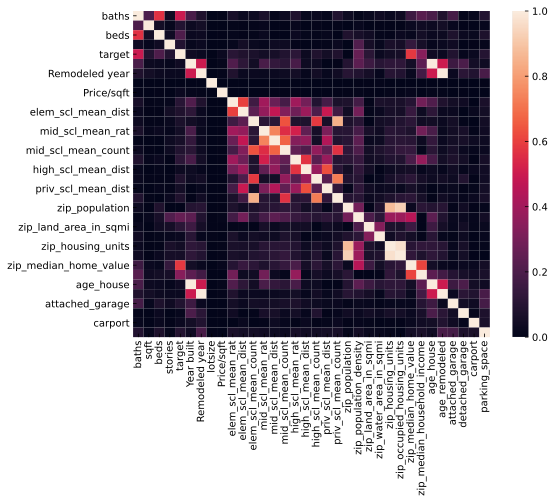

In [180]:
# Посмотрим на тепловую карту корреляции признаков
plt.subplots(figsize=(8, 6))
sns.heatmap(df.corr().abs(), vmin=0, vmax=1)

In [181]:
# Таблица корреляции признаков
df.corr().abs().sort_values(by='target', ascending=False)

,baths,sqft,beds,stories,target,Year built,Remodeled year,lotsize,Price/sqft,elem_scl_mean_rat,...,zip_housing_units,zip_occupied_housing_units,zip_median_home_value,zip_median_household_income,age_house,age_remodeled,attached_garage,detached_garage,carport,parking_space
target,0.496379,0.092984,0.204898,0.090857,1.000000,0.039953,0.027813,0.000289,0.027977,0.105801,...,0.049509,0.057809,0.585197,0.341109,0.039953,0.027813,0.088318,0.015783,0.028884,0.093926
zip_median_home_value,0.162078,0.030484,0.022728,0.140408,0.585197,0.053624,0.025703,0.002032,0.016752,0.098095,...,0.106651,0.126279,1.000000,0.612866,0.053624,0.025703,0.017751,0.029185,0.025356,0.054667
baths,1.000000,0.202099,0.569230,0.040954,0.496379,0.194327,0.085719,0.000653,0.007485,0.065729,...,0.030130,0.039411,0.162078,0.230242,0.194327,0.085719,0.181591,0.009035,0.020943,0.093254
zip_median_household_income,0.230242,0.041540,0.053409,0.059867,0.341109,0.240380,0.175461,0.001421,0.003826,0.289788,...,0.127726,0.080508,0.612866,1.000000,0.240380,0.175461,0.100207,0.065802,0.046275,0.067900
zip_population_density,0.008275,0.022778,0.063452,0.213657,0.264796,0.239237,0.088718,0.004019,0.013343,0.175854,...,0.385290,0.387601,0.452559,0.004883,0.239237,0.088718,0.027156,0.029820,0.018604,0.047599
beds,0.569230,0.052039,1.000000,0.041157,0.204898,0.029262,0.033061,0.001499,0.005104,0.014410,...,0.008595,0.028784,0.022728,0.053409,0.029262,0.033061,0.078365,0.031207,0.024505,0.077369
high_scl_mean_rat,0.084773,0.018605,0.028947,0.007792,0.115149,0.188698,0.051822,0.002478,0.005082,0.397965,...,0.090069,0.088411,0.194947,0.371883,0.188698,0.051822,0.077568,0.051350,0.004424,0.056811
zip_land_area_in_sqmi,0.023760,0.001404,0.046836,0.056456,0.112175,0.163865,0.057897,0.005769,0.005019,0.010254,...,0.081309,0.072113,0.158848,0.002777,0.163865,0.057897,0.022871,0.046883,0.015175,0.024827
elem_scl_mean_rat,0.065729,0.008591,0.014410,0.019229,0.105801,0.210437,0.083253,0.000661,0.000448,1.000000,...,0.070155,0.066852,0.098095,0.289788,0.210437,0.083253,0.054239,0.041540,0.001375,0.069995
parking_space,0.093254,0.015680,0.077369,0.015130,0.093926,0.041197,0.190432,0.007437,0.000280,0.069995,...,0.014191,0.000809,0.054667,0.067900,0.041197,0.190432,0.182037,0.075562,0.067797,1.000000


Числовые признаки, которые наиболее коррелируют с целевой переменной:
- zip_median_home_value - 0.585197
- baths - 0.585197
- zip_median_household_income - 0.341109
- zip_population_density - 0.264796	
- beds - 0.204898
- high_scl_mean_rat - 0.115149
- zip_land_area_in_sqmi - 0.112175
- elem_scl_mean_rat - 0.105801
- parking_space - 0.093926
- sqft - 0.092984

Вполне ожидаемо, что на первом месте показатель медианного стоимости жилья для почтогого индекса с корреляцией 59%, но достаточно странно, что у площади жилья корелляция с целевой переменной всего 9%. Возможно в признаке sqft есть ошибки.

In [182]:
# Посмотрим на Boxplot для категорийных признаков с небольшим каличеством категорий
for col in categorical_features_usual_options:
    get_boxplot(col)

Признак status: 
- минимальное значение target для категории аренда. Разница между ней и остальными категориями в 2 порядка
- максимальная верхняя граница значения target для категории new ~1.3 млн.
- категории active, for sale, unknown - практически одинаковые 1й, 2й и 3й квартили
- для всех категорий признака имеются "выбросы". Здесь и далее под выбросами мы будем понимать не ошибку в данных (разное жилье может стоить и 50 тыс. и 50 млн.), а статистические выбросы. Хотя, возможно, где-то в данных имеются ошибки.

Признак propertyType: 
- максимальная верхняя граница значения target для категории multi-family ~2.25 млн.
- минимальная верхняя граница значения target для категории manufactured ~0.33 млн.
- для всех категорий признака имеются "выбросы"

Признак state: 
- максимальная верхняя граница значения target для штатов CA  ~2.05 млн и NY ~2 млн.
- минимальная верхняя граница значения target для штата AL  ~2.05 млн NY ~0.1 млн.
- для всех штатов кроме AL имеются "выбросы"

Признак Heating: 
- максимальная верхняя граница значения target для категории unknown  ~1.15 млн.
- минимальная верхняя граница значения target для категории electric  ~0.9 млн.
- для всех категорий признака имеются "выбросы"

Признак Cooling: 
- максимальная верхняя граница значения target для категории ceiling fan  ~1.5 млн.
- максимальная верхняя граница значения target для категории no cooling  ~0.3 млн.
- для всех категорий признака имеются "выбросы"

In [183]:
# Проведем тест Стьюдента для категорийных признаков  с большим каличеством категорий
for col in categorical_features_large_options:
    get_stat_dif(col)

# Проведем тест Стьюдента для категорийных признаков  с небольшим каличеством категорий
for col in categorical_features_usual_options:
    get_stat_dif(col)

Статистически значимые различия были обнаружены для столбца city
Статистически значимые различия были обнаружены для столбца zipcode
Статистически значимые различия были обнаружены для столбца street_name
Статистически значимые различия были обнаружены для столбца status
Статистически значимые различия были обнаружены для столбца propertyType
Статистически значимые различия были обнаружены для столбца state
Статистически значимые различия были обнаружены для столбца Heating
Статистически значимые различия были обнаружены для столбца Cooling


Статистически значимые различия были обнаружены для всех категорийных признаков

In [184]:
# # Сохраним датафрейм
# df.to_csv('data\df.csv')

In [185]:
# df = pd.read_csv('data\df.csv', index_col=0)

In [ ]:
def preparing_num_column(df, column):
    # Функция принимает на вход название числового столбца и производит рассчет:
    #    1) границ выбросов
    #    2) количества значений выходящих за границы выбросов
    #    3) уникальные значения выходящих за границы выбросов
    #    4) индексы записей выходящих за границы выбросов

    col = df.loc[:, column]
    outlier_index_lst = []
    if col.dtype in ['int64', 'float64', 'int32']:
        col = col.apply(lambda x: None if pd.isnull(x)
                        else None if x == 'Nan' else x)
        print('Числовая переменная:')
        print(column)
        print('Количество пустых значений - ',
              df.loc[:, column].isnull().sum())
        print('Количество значений "0" - ', len(df[df.loc[:, column] == 0]))
        print(col.describe())
        median = col.median()
        IQR = col.quantile(0.75) - col.quantile(0.25)
        perc25 = col.quantile(0.25)
        perc75 = col.quantile(0.75)
        lower_limit = perc25 - 1.5*IQR
        upper_limit = perc75 + 1.5*IQR
        print('25-й перцентиль: {},'.format(perc25), '75-й перцентиль: {},'.format(perc75),
              "IQR: {}, ".format(IQR), "Границы выбросов: [{}, {}].".format(lower_limit, upper_limit))
        print('Количество значений, выходящих за границы выбросов -',
              len(df.query('(@col<@lower_limit)or(@col>@upper_limit)')))
        print('Уникальные значения, выходящие за границы выбросов -',
              sorted(list(df.query('(@col<@lower_limit)or(@col>@upper_limit)')[column].unique())))
        outlier_index_lst = list(
            df.query('(@col<@lower_limit)or(@col>@upper_limit)').index)
#         print('Индексы значений, выходящие за границы выбросов -', sorted(outlier_index_lst))

    print()
    return outlier_index_lst


# Проверим выбросы в столбцах target, lotsize, beds, baths, sqft и удалим их
# Создаем копию датафрейма
df2 = df.copy()
# Создадим список категорий в столбце status
status_lst = df2.status.unique()
# Создадим список категорий в столбце propertyType
propertyType_lst = df2.propertyType.unique()
target_outlier_count = 0
lotsize_outlier_count = 0
beds_outlier_count = 0
baths_outlier_count = 0
sqft_outlier_count = 0
for status in status_lst:
    for propertyType in propertyType_lst:
        # В зависимости от сочетания значений в столбцах status и propertyType создаем датафрейм с выбранными категориями
        group_df = df2[(df2['status'] == status) & (
            df2['propertyType'] == propertyType)]
        print(f'status={status}, propertyType={propertyType}')
        # Делаем проверку на выбросы в столбцах target, lotsize, beds, baths, sqft и удаляем выбросы
        outlier_index_lst = preparing_num_column(group_df, 'target')
        target_outlier_count += len(outlier_index_lst)
        df2 = df2[~df2.index.isin(outlier_index_lst)]
        outlier_index_lst = preparing_num_column(group_df, 'lotsize')
        lotsize_outlier_count += len(outlier_index_lst)
        df2 = df2[~df2.index.isin(outlier_index_lst)]
        outlier_index_lst = preparing_num_column(group_df, 'beds')
        beds_outlier_count += len(outlier_index_lst)
        df2 = df2[~df2.index.isin(outlier_index_lst)]
        outlier_index_lst = preparing_num_column(group_df, 'baths')
        baths_outlier_count += len(outlier_index_lst)
        df2 = df2[~df2.index.isin(outlier_index_lst)]
        outlier_index_lst = preparing_num_column(group_df, 'sqft')
        sqft_outlier_count += len(outlier_index_lst)
        df2 = df2[~df2.index.isin(outlier_index_lst)]
print(f'Удалено выбросов в столбце target - {target_outlier_count}')
print(f'Удалено выбросов в столбце lotsize - {lotsize_outlier_count}')
print(f'Удалено выбросов в столбце beds - {beds_outlier_count}')
print(f'Удалено выбросов в столбце baths - {baths_outlier_count}')
print(f'Удалено выбросов в столбце sqft - {sqft_outlier_count}')
print(
    f'Размер датафрейма до удаления выбросов - {len(df)}, после удаления - {len(df2)}')

status=active, propertyType=houses
Числовая переменная:
target
Количество пустых значений -  0
Количество значений "0" -  0
count    4.590600e+04
mean     4.636645e+05
std      4.327450e+05
min      1.000000e+04
25%      2.230000e+05
50%      3.300000e+05
75%      5.297250e+05
max      3.000000e+06
Name: target, dtype: float64
25-й перцентиль: 223000.0, 75-й перцентиль: 529725.0, IQR: 306725.0,  Границы выбросов: [-237087.5, 989812.5].
Количество значений, выходящих за границы выбросов - 3950
Уникальные значения, выходящие за границы выбросов - [989900.0, 989990.0, 990000.0, 990490.0, 990900.0, 991900.0, 991990.0, 994000.0, 994900.0, 994925.0, 994992.0, 995000.0, 996000.0, 997000.0, 997250.0, 997500.0, 997900.0, 998000.0, 998380.0, 998500.0, 998800.0, 998900.0, 999000.0, 999500.0, 999725.0, 999800.0, 999900.0, 999950.0, 999995.0, 999998.0, 999999.0, 1000000.0, 1000999.0, 1012600.0, 1015000.0, 1017000.0, 1017800.0, 1018000.0, 1019000.0, 1020000.0, 1021000.0, 1023000.0, 1024900.0, 102500

Числовая переменная:
lotsize
Количество пустых значений -  0
Количество значений "0" -  9051
count    4.590600e+04
mean     4.729889e+04
std      7.449797e+05
min      0.000000e+00
25%      3.296250e+03
50%      7.500000e+03
75%      1.219700e+04
max      9.618057e+07
Name: lotsize, dtype: float64
25-й перцентиль: 3296.25, 75-й перцентиль: 12197.0, IQR: 8900.75,  Границы выбросов: [-10054.875, 25548.125].
Количество значений, выходящих за границы выбросов - 5509
Уникальные значения, выходящие за границы выбросов - [25560.0, 25570.0, 25578.0, 25583.0, 25596.0, 25616.0, 25658.0, 25700.0, 25703.0, 25740.0, 25788.0, 25801.0, 25883.0, 25908.0, 25918.0, 25923.0, 26000.0, 26001.0, 26005.0, 26010.0, 26085.0, 26092.0, 26125.0, 26136.0, 26195.0, 26284.0, 26308.0, 26336.0, 26484.0, 26572.0, 26675.0, 26702.0, 26703.0, 26717.0, 26746.0, 26781.0, 26858.0, 26863.0, 26877.0, 26938.0, 26953.0, 27000.0, 27007.0, 27037.0, 27038.0, 27050.0, 27134.0, 27138.0, 27181.0, 27199.0, 27214.0, 27225.0, 27331.0, 27

Числовая переменная:
beds
Количество пустых значений -  0
Количество значений "0" -  66
count    45906.000000
mean         3.212391
std          0.734498
min          0.000000
25%          3.000000
50%          3.000000
75%          3.000000
max         15.000000
Name: beds, dtype: float64
25-й перцентиль: 3.0, 75-й перцентиль: 3.0, IQR: 0.0,  Границы выбросов: [3.0, 3.0].
Количество значений, выходящих за границы выбросов - 11695
Уникальные значения, выходящие за границы выбросов - [0.0, 1.0, 2.0, 4.0, 5.0, 6.0, 7.0, 8.0, 9.0, 10.0, 11.0, 12.0, 13.0, 14.0, 15.0]

Числовая переменная:
baths
Количество пустых значений -  17665
Количество значений "0" -  112
count    28241.000000
mean         2.602370
std          0.949628
min          0.000000
25%          2.000000
50%          2.500000
75%          3.000000
max         20.000000
Name: baths, dtype: float64
25-й перцентиль: 2.0, 75-й перцентиль: 3.0, IQR: 1.0,  Границы выбросов: [0.5, 4.5].
Количество значений, выходящих за границы выбр

status=active, propertyType=lots/land
Числовая переменная:
target
Количество пустых значений -  0
Количество значений "0" -  0
count    7.980000e+03
mean     1.934947e+05
std      3.684311e+05
min      1.000000e+04
25%      2.500000e+04
50%      5.900000e+04
75%      1.800000e+05
max      3.000000e+06
Name: target, dtype: float64
25-й перцентиль: 25000.0, 75-й перцентиль: 180000.0, IQR: 155000.0,  Границы выбросов: [-207500.0, 412500.0].
Количество значений, выходящих за границы выбросов - 920
Уникальные значения, выходящие за границы выбросов - [413580.0, 414990.0, 415000.0, 417718.0, 419000.0, 419805.0, 420000.0, 421660.0, 423500.0, 424900.0, 425000.0, 425500.0, 427500.0, 429000.0, 429900.0, 430000.0, 430373.0, 430650.0, 435000.0, 435200.0, 435600.0, 439000.0, 440000.0, 441000.0, 444000.0, 445000.0, 448000.0, 449000.0, 449900.0, 450000.0, 459000.0, 460000.0, 465000.0, 466081.0, 467640.0, 469000.0, 471500.0, 474500.0, 475000.0, 479000.0, 480000.0, 485000.0, 485100.0, 487300.0, 487500.

Числовая переменная:
beds
Количество пустых значений -  0
Количество значений "0" -  154
count    7980.000000
mean        2.942857
std         0.421258
min         0.000000
25%         3.000000
50%         3.000000
75%         3.000000
max         8.000000
Name: beds, dtype: float64
25-й перцентиль: 3.0, 75-й перцентиль: 3.0, IQR: 0.0,  Границы выбросов: [3.0, 3.0].
Количество значений, выходящих за границы выбросов - 162
Уникальные значения, выходящие за границы выбросов - [0.0, 1.0, 2.0, 4.0, 5.0, 7.0, 8.0]

Числовая переменная:
baths
Количество пустых значений -  5483
Количество значений "0" -  2486
count    2497.000000
mean        0.007409
std         0.124378
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max         4.000000
Name: baths, dtype: float64
25-й перцентиль: 0.0, 75-й перцентиль: 0.0, IQR: 0.0,  Границы выбросов: [0.0, 0.0].
Количество значений, выходящих за границы выбросов - 11
Уникальные значения, выходящие за границы выбросов - 

Числовая переменная:
beds
Количество пустых значений -  0
Количество значений "0" -  71
count    6485.000000
mean        2.493755
std         0.885920
min         0.000000
25%         2.000000
50%         3.000000
75%         3.000000
max        12.000000
Name: beds, dtype: float64
25-й перцентиль: 2.0, 75-й перцентиль: 3.0, IQR: 1.0,  Границы выбросов: [0.5, 4.5].
Количество значений, выходящих за границы выбросов - 163
Уникальные значения, выходящие за границы выбросов - [0.0, 5.0, 6.0, 7.0, 8.0, 9.0, 12.0]

Числовая переменная:
baths
Количество пустых значений -  732
Количество значений "0" -  18
count    5753.000000
mean        2.237514
std         0.848460
min         0.000000
25%         2.000000
50%         2.000000
75%         3.000000
max         8.510000
Name: baths, dtype: float64
25-й перцентиль: 2.0, 75-й перцентиль: 3.0, IQR: 1.0,  Границы выбросов: [0.5, 4.5].
Количество значений, выходящих за границы выбросов - 36
Уникальные значения, выходящие за границы выбросов - [0.

Числовая переменная:
lotsize
Количество пустых значений -  0
Количество значений "0" -  1293
count    4.197000e+03
mean     1.636379e+04
std      1.347981e+05
min      0.000000e+00
25%      0.000000e+00
50%      4.640000e+03
75%      8.659000e+03
max      4.939709e+06
Name: lotsize, dtype: float64
25-й перцентиль: 0.0, 75-й перцентиль: 8659.0, IQR: 8659.0,  Границы выбросов: [-12988.5, 21647.5].
Количество значений, выходящих за границы выбросов - 377
Уникальные значения, выходящие за границы выбросов - [21780.0, 22216.0, 22651.0, 23087.0, 23522.0, 23958.0, 24000.0, 24394.0, 24829.0, 25265.0, 25700.0, 26136.0, 26572.0, 27007.0, 27443.0, 27878.0, 28314.0, 28750.0, 29185.0, 29620.0, 29621.0, 30056.0, 30492.0, 30928.0, 31363.0, 31799.0, 32234.0, 32670.0, 33106.0, 33541.0, 33977.0, 34412.0, 34848.0, 35284.0, 35719.0, 36155.0, 36590.0, 37026.0, 37462.0, 37897.0, 38333.0, 38768.0, 39204.0, 39640.0, 40075.0, 40511.0, 41382.0, 41818.0, 42253.0, 43124.0, 43560.0, 43996.0, 44431.0, 44867.0, 4530

Числовая переменная:
sqft
Количество пустых значений -  0
Количество значений "0" -  0
count     1028.000000
mean      2923.459144
std       3928.783987
min        540.000000
25%       1844.000000
50%       2233.500000
75%       3188.000000
max      99999.000000
Name: sqft, dtype: float64
25-й перцентиль: 1844.0, 75-й перцентиль: 3188.0, IQR: 1344.0,  Границы выбросов: [-172.0, 5204.0].
Количество значений, выходящих за границы выбросов - 78
Уникальные значения, выходящие за границы выбросов - [5208.0, 5214.0, 5237.0, 5292.0, 5297.0, 5300.0, 5301.0, 5328.0, 5350.0, 5358.0, 5368.0, 5395.0, 5418.0, 5425.0, 5439.0, 5494.0, 5500.0, 5522.0, 5552.0, 5616.0, 5630.0, 5634.0, 5640.0, 5645.0, 5673.0, 5715.0, 5796.0, 5816.0, 5840.0, 5906.0, 5908.0, 5920.0, 5941.0, 6000.0, 6016.0, 6042.0, 6144.0, 6156.0, 6169.0, 6170.0, 6203.0, 6279.0, 6324.0, 6353.0, 6365.0, 6384.0, 6407.0, 6412.0, 6463.0, 6478.0, 6524.0, 6564.0, 6638.0, 6674.0, 6680.0, 6720.0, 7014.0, 7116.0, 7276.0, 7325.0, 7386.0, 7588.0, 8144


Числовая переменная:
lotsize
Количество пустых значений -  0
Количество значений "0" -  9131
count    1.144330e+05
mean     1.052811e+05
std      7.895197e+06
min      0.000000e+00
25%      5.000000e+03
50%      7.536000e+03
75%      1.176100e+04
max      2.147466e+09
Name: lotsize, dtype: float64
25-й перцентиль: 5000.0, 75-й перцентиль: 11761.0, IQR: 6761.0,  Границы выбросов: [-5141.5, 21902.5].
Количество значений, выходящих за границы выбросов - 11820
Уникальные значения, выходящие за границы выбросов - [22033.0, 22125.0, 22216.0, 22260.0, 22299.0, 22329.0, 22330.0, 22359.0, 22651.0, 22700.0, 22956.0, 22989.0, 23056.0, 23087.0, 23261.0, 23268.0, 23384.0, 23522.0, 23592.0, 23601.0, 23625.0, 23627.0, 23662.0, 23827.0, 23914.0, 23932.0, 23958.0, 23999.0, 24002.0, 24058.0, 24219.0, 24226.0, 24394.0, 24437.0, 24459.0, 24562.0, 24565.0, 24681.0, 24829.0, 24890.0, 24898.0, 25102.0, 25265.0, 25304.0, 25474.0, 25509.0, 25575.0, 25700.0, 25962.0, 26111.0, 26136.0, 26569.0, 26572.0, 26877.0

Числовая переменная:
beds
Количество пустых значений -  0
Количество значений "0" -  50
count    114433.000000
mean          3.525696
std           0.961792
min           0.000000
25%           3.000000
50%           3.000000
75%           4.000000
max          44.000000
Name: beds, dtype: float64
25-й перцентиль: 3.0, 75-й перцентиль: 4.0, IQR: 1.0,  Границы выбросов: [1.5, 5.5].
Количество значений, выходящих за границы выбросов - 3266
Уникальные значения, выходящие за границы выбросов - [0.0, 1.0, 6.0, 7.0, 8.0, 9.0, 10.0, 11.0, 12.0, 13.0, 14.0, 16.0, 20.0, 23.0, 42.0, 44.0]

Числовая переменная:
baths
Количество пустых значений -  9912
Количество значений "0" -  10
count    104521.000000
mean          2.808354
std           1.151369
min           0.000000
25%           2.000000
50%           3.000000
75%           3.000000
max          30.000000
Name: baths, dtype: float64
25-й перцентиль: 2.0, 75-й перцентиль: 3.0, IQR: 1.0,  Границы выбросов: [0.5, 4.5].
Количество значений, вых

- Удалено выбросов в столбце target - 24350
- Удалено выбросов в столбце lotsize - 36140
- Удалено выбросов в столбце beds - 27938
- Удалено выбросов в столбце baths - 15492
- Удалено выбросов в столбце sqft - 15440
- Размер датафрейма до удаления выбросов - 303100, после удаления - 220286

In [ ]:
# Создадим функцию для подготовки данных
def preproc_data(df_input):

    def FeatureHasher_df(df, column):
        '''функция принимает на вход DataFrame и имя категорийного столбца и преобразует его в серию числовых столбцов 
        с помощью sklearn.feature_extraction.FeatureHasher и возвращает новый DataFrame,
        в который добавлена серия числовых столбцов и удален заданный категорийный столбец column'''
        h = FeatureHasher(n_features=10, input_type='string')
        f = h.transform(df[column])
        df1 = pd.DataFrame(f.toarray(), index=df.index)
        for col in df1.columns:
            df1.rename(columns={col: column+'_'+str(col)}, inplace=True)
    #     df1[column] = df[column]
        df2 = pd.concat([df, df1], axis=1)
        df2.drop(column, axis=1, inplace=True)
        return df2

    # Создаем копию данных
    df_output = df_input.copy()

    # Категорийные признаки с большим количеством вариантов
    categorical_features_large_options = [
        'city',
        'zipcode',
        'street_name'
    ]

    # Категорийные признаки с небольшим количеством вариантов
    categorical_features_usual_options = [
        'status',
        'propertyType',
        'state',
        'Heating',
        'Cooling'
    ]

    # Числовые признаки
    numerical_features = [
        'baths',
        'sqft',
        'beds',
        #         'target',
        'lotsize',
        'fireplace',
        'stories',
        'elem_scl_mean_rat',
        'elem_scl_mean_dist',
        'elem_scl_mean_count',
        'mid_scl_mean_rat',
        'mid_scl_mean_dist',
        'mid_scl_mean_count',
        'high_scl_mean_rat',
        'high_scl_mean_dist',
        'high_scl_mean_count',
        'priv_scl_mean_dist',
        'priv_scl_mean_count',
        'zip_population',
        'zip_population_density',
        'zip_land_area_in_sqmi',
        'zip_water_area_in_sqmi',
        'zip_housing_units',
        'zip_occupied_housing_units',
        'zip_median_home_value',
        'zip_median_household_income',
        'age_house',
        'age_remodeled',
        'carport',
        'parking_space'
    ]

    # Производим изменение типов данных
#     df_output[numerical_features] = df_output[numerical_features].fillna(0)
    df_output.PrivatePool = df_output.PrivatePool.astype(int)
    df_output.MLS = df_output.MLS.astype(int)
    df_output.zipcode = df_output.zipcode.astype(str)

    # Логарифмирование не производим т.к. при расчете нейросети метрика MAPE = nan
    # Проводим логарифмирование
#     df_output['baths'] = np.log(df_output['baths'])
#     df_output['sqft'] = np.log(df_output['sqft'])
#     df_output['beds'] = np.log(df_output['beds'])
#     df_output['lotsize'] = np.log(df_output['lotsize'])
#     df_output['elem_scl_mean_rat'] = np.log(df_output['elem_scl_mean_rat'])
#     df_output['mid_scl_mean_rat'] = np.log(df_output['mid_scl_mean_rat'])
#     df_output['high_scl_mean_rat'] = np.log(df_output['high_scl_mean_rat'])
#     df_output['age_house'] = np.log(df_output['age_house'])
#     df_output['age_remodeled'] = np.log(df_output['age_remodeled'])
#     df_output['zip_population'] = np.log(df_output['zip_population'])
#     df_output['zip_population_density'] = np.log(df_output['zip_population_density'])
#     df_output['zip_land_area_in_sqmi'] = np.log(df_output['zip_land_area_in_sqmi'])
#     df_output['zip_water_area_in_sqmi'] = np.log(df_output['zip_water_area_in_sqmi'])
#     df_output['zip_housing_units'] = np.log(df_output['zip_housing_units'])
#     df_output['zip_occupied_housing_units'] = np.log(df_output['zip_occupied_housing_units'])
#     df_output['zip_median_home_value'] = np.log(df_output['zip_median_home_value'])
#     df_output['zip_median_household_income'] = np.log(df_output['zip_median_household_income'])

    # Удаляем записи со значением в столбце status = 'unknown'
    df_output = df_output[df_output['status'] != 'unknown']
    # Удаляем записи со значением в столбце propertyType = 'unknown'
    df_output = df_output[df_output['propertyType'] != 'unknown']
    # Оставляем записи со значением target  больше 30 тыс и менее 1 млн.
    df_output = df_output[(df_output['target'] > 30000)
                          & (df_output['target'] < 1000000)]
    df_output = df_output[(df_output['target'] > 30000)
                          & (df_output['status'] != 'for rent')]

#     Делаем нормализацию для числовых признаков
    scaler = MinMaxScaler()
    for column in numerical_features:
        #         print(column)
        df_output[column] = scaler.fit_transform(df_output[[column]])[:, 0]

#     # One-hot encoding.
    for column in categorical_features_usual_options:
        df_output[column] = df_output[column].astype('category').cat.codes

    df_output = pd.get_dummies(
        df_output,
        columns=categorical_features_usual_options,
        dummy_na=False
    )

    # Кодируем категорийные столбцы с большим количеством категорий
    for column in categorical_features_large_options:
        df_output = FeatureHasher_df(df_output, column)

    df_output = df_output.fillna(0)

    # Удаляем ненужные столбцы
    df_output.drop([
        'baths',
        'private pool',
        'street',
        'homeFacts',
        'schools',
        'mls-id',
        'MlsId',
        'Year built',
        'Remodeled year',
        'Price/sqft',
        'house_num',
    ], axis=1, inplace=True)

    return df_output


df3 = preproc_data(df2)

In [ ]:
list(df3.columns)

In [ ]:
df3

## 8. Model 0: Наивная модель

In [ ]:
# split данных
train = df2
data_train, data_test = train_test_split(
    train, test_size=0.15, shuffle=True, random_state=RANDOM_SEED)

predicts = (pd.DataFrame(data_train.groupby(['status', 'propertyType'])['target'].median())
            .reset_index()
            .rename(columns={'target': 'target_pred'}))
data_test['id'] = data_test['status'].astype(
    str) + data_test['propertyType'].astype(str)
predicts['id'] = predicts['status'].astype(
    str) + predicts['propertyType'].astype(str)

# predicts = pd.DataFrame(data_train.groupby(['status', 'propertyType'])['target'].median()).reset_index()
# data_test['id'] = data_test['status'].astype(str) + data_test['propertyType'].astype(str)
# predicts['id'] = predicts['status'].astype(str) + predicts['propertyType'].astype(str)

predicts = pd.merge(data_test[['id', 'target']], predicts[['id', 'target_pred']], left_on=[
    'id'], right_on=['id'], how='left')

# заполним не найденные совпадения
predicts.target_pred = predicts.target_pred.fillna(
    predicts.target_pred.median())
predicts['mistake%'] = (predicts['target_pred'] -
                        predicts['target'])/predicts['target']
predicts = predicts.sort_values(by=['mistake%']).rename(
    columns={'target': 'target_true'})

# оцениваем точность
print(
    f"Точность наивной модели по метрике MAPE: {(mape(predicts['target_pred'], predicts['target_true']))*100:0.2f}%")

predicts

## 9. Model 1: CatBoost

In [191]:
y = df3.target.values     # наш таргет
X = df3.drop(['target'], axis=1)

# Split
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.15, shuffle=True, random_state=RANDOM_SEED)

# Создаем модель
model1 = CatBoostRegressor(
    iterations=10000,
    random_seed=RANDOM_SEED,
    eval_metric='MAPE',
    custom_metric=['MAPE', 'MAPE'],
    od_wait=100
)

# Обучение CatBoost
model1.fit(
    X_train,
    y_train,
    eval_set=(X_test, y_test),
    verbose_eval=100,
    use_best_model=True
)

test_predict_catboost = model1.predict(X_test)
print(f"TEST mape: {(mape(y_test, test_predict_catboost))*100:0.2f}%")

Learning rate set to 0.028495
0:	learn: 0.8819497	test: 0.8758349	best: 0.8758349 (0)	total: 310ms	remaining: 51m 35s
100:	learn: 0.4075595	test: 0.4033879	best: 0.4033879 (100)	total: 5.23s	remaining: 8m 32s
200:	learn: 0.3404572	test: 0.3366425	best: 0.3366425 (200)	total: 9.25s	remaining: 7m 31s
300:	learn: 0.3155681	test: 0.3123758	best: 0.3123758 (300)	total: 13.3s	remaining: 7m 7s
400:	learn: 0.2999552	test: 0.2971899	best: 0.2971899 (400)	total: 16.9s	remaining: 6m 44s
500:	learn: 0.2899597	test: 0.2877249	best: 0.2877249 (500)	total: 20.9s	remaining: 6m 35s
600:	learn: 0.2820745	test: 0.2803074	best: 0.2803074 (600)	total: 24.3s	remaining: 6m 20s
700:	learn: 0.2756679	test: 0.2741551	best: 0.2741551 (700)	total: 27.7s	remaining: 6m 6s
800:	learn: 0.2701187	test: 0.2689874	best: 0.2689874 (800)	total: 31.1s	remaining: 5m 57s
900:	learn: 0.2655597	test: 0.2648019	best: 0.2648019 (900)	total: 34.4s	remaining: 5m 47s
1000:	learn: 0.2615917	test: 0.2611968	best: 0.2611968 (1000)	tot

8800:	learn: 0.1931648	test: 0.2116299	best: 0.2116272 (8798)	total: 4m 47s	remaining: 39.1s
8900:	learn: 0.1927963	test: 0.2114525	best: 0.2114516 (8898)	total: 4m 50s	remaining: 35.8s
9000:	learn: 0.1923617	test: 0.2112288	best: 0.2112288 (9000)	total: 4m 53s	remaining: 32.5s
9100:	learn: 0.1919947	test: 0.2110353	best: 0.2110353 (9100)	total: 4m 56s	remaining: 29.3s
9200:	learn: 0.1916847	test: 0.2109008	best: 0.2109008 (9200)	total: 4m 59s	remaining: 26s
9300:	learn: 0.1913643	test: 0.2107567	best: 0.2107564 (9299)	total: 5m 2s	remaining: 22.7s
9400:	learn: 0.1910566	test: 0.2106235	best: 0.2106224 (9394)	total: 5m 5s	remaining: 19.5s
9500:	learn: 0.1907260	test: 0.2104435	best: 0.2104435 (9500)	total: 5m 8s	remaining: 16.2s
9600:	learn: 0.1903469	test: 0.2102511	best: 0.2102511 (9600)	total: 5m 12s	remaining: 13s
9700:	learn: 0.1899568	test: 0.2100356	best: 0.2100356 (9700)	total: 5m 15s	remaining: 9.73s
9800:	learn: 0.1895977	test: 0.2098610	best: 0.2098610 (9800)	total: 5m 19s	r

По сравнению с наивной моделью (MAPE: 58.34%) с помощью CatBoost мы улучшили метрику до 20.96%

## 10. Model 2: RandomForestRegressor

In [192]:
model2 = RandomForestRegressor(random_state=42, n_estimators=100)

model2.fit(X_train, y_train)
model2_test_predict = model2.predict(X_test)
print(f"Test MAPE: {mape(y_test, model2_test_predict)*100:0.3f}%")

Test MAPE: 20.269%


По сравнению с CatBoost (MAPE: 20.96%) с помощью RandomForestRegressor мы улучшили метрику до 20.29%

## 11. Model 3: GradientBoostingRegressor

In [193]:
model3 = GradientBoostingRegressor(
    max_depth=7, n_estimators=100, learning_rate=0.1, random_state=42)
model3.fit(X_train, y_train)
model3_test_predict = model3.predict(X_test)
print(
    f"GradientBoostingRegressor Test MAPE: {mape(y_test, model3_test_predict)*100:0.3f}%")

GradientBoostingRegressor Test MAPE: 24.922%


Метрика MAPE: 24.97% ухудшилась по сравнению с RandomForestRegressor (MAPE: 20.29%)

## 12. Model 4: Простая полносвязная нейросеть

Epoch 1/100
304/304 [==============================] - 133s 130ms/step - loss: 56.6738 - MAPE: 56.6737 - val_loss: 29.3193 - val_MAPE: 29.3192
Epoch 2/100
304/304 [==============================] - 6s 20ms/step - loss: 31.6708 - MAPE: 31.6708 - val_loss: 27.7979 - val_MAPE: 27.7979
Epoch 3/100
304/304 [==============================] - 6s 20ms/step - loss: 30.4598 - MAPE: 30.4598 - val_loss: 26.8142 - val_MAPE: 26.8141
Epoch 4/100
304/304 [==============================] - 6s 19ms/step - loss: 29.6326 - MAPE: 29.6325 - val_loss: 25.6091 - val_MAPE: 25.6089
Epoch 5/100
304/304 [==============================] - 6s 19ms/step - loss: 29.3547 - MAPE: 29.3546 - val_loss: 25.2604 - val_MAPE: 25.2603
Epoch 6/100
304/304 [==============================] - 6s 19ms/step - loss: 28.8751 - MAPE: 28.8749 - val_loss: 25.1245 - val_MAPE: 25.1244
Epoch 7/100
304/304 [==============================] - 6s 19ms/step - loss: 28.6907 - MAPE: 28.6905 - val_loss: 24.6856 - val_MAPE: 24.6855
Epoch 8/100
304/3

304/304 [==============================] - 9s 29ms/step - loss: 25.7412 - MAPE: 25.7406 - val_loss: 21.8273 - val_MAPE: 21.8267
Epoch 60/100
304/304 [==============================] - 7s 22ms/step - loss: 25.6034 - MAPE: 25.6027 - val_loss: 21.7693 - val_MAPE: 21.7687
Epoch 61/100
304/304 [==============================] - 6s 19ms/step - loss: 25.5281 - MAPE: 25.5275 - val_loss: 21.8583 - val_MAPE: 21.8576
Epoch 62/100
304/304 [==============================] - 9s 31ms/step - loss: 25.5027 - MAPE: 25.5021 - val_loss: 21.7306 - val_MAPE: 21.7299
Epoch 63/100
304/304 [==============================] - 6s 19ms/step - loss: 25.7016 - MAPE: 25.7009 - val_loss: 21.5537 - val_MAPE: 21.5530
Epoch 64/100
304/304 [==============================] - 6s 19ms/step - loss: 25.4380 - MAPE: 25.4373 - val_loss: 21.6748 - val_MAPE: 21.6741
Epoch 65/100
304/304 [==============================] - 6s 19ms/step - loss: 25.4968 - MAPE: 25.4961 - val_loss: 21.9646 - val_MAPE: 21.9639
Epoch 66/100
304/304 [====

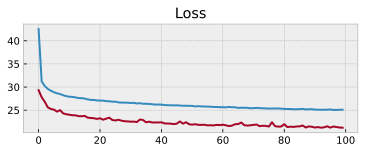

TEST mape: 21.21%


In [194]:
# Создаем модель
model4 = Sequential()

model4.add(L.Dense(512, input_dim=X_train.shape[1], kernel_regularizer=regularizers.l1_l2(l1=0.000000001,
                                                                                          l2=0.000000001), activation="relu"))

model4.add(L.Dropout(0.5))
model4.add(L.Dense(256, kernel_regularizer=regularizers.l1_l2(l1=0.000000001,
                                                              l2=0.000000001), activation="relu"))

model4.add(L.Dropout(0.5))
model4.add(L.Dense(128, activation="relu"))

model4.add(L.Dropout(0.5))
model4.add(L.Dense(1, activation="linear"))

# Задаем оптимайзер Adam с шагом 0.01
optimizer = tf.keras.optimizers.Adam(0.01)
model4.compile(loss='MAPE', optimizer=optimizer, metrics=['MAPE'])

# Добавляем checkpoint
checkpoint = ModelCheckpoint(
    './data/best_model.hdf5', monitor=['val_MAPE'], verbose=0, mode='min')
earlystop = EarlyStopping(
    monitor='val_MAPE', patience=50, restore_best_weights=True,)
callbacks_list = [checkpoint, earlystop]

# Обучаем
history = model4.fit(X_train, y_train,
                     batch_size=512,
                     epochs=100,  # фактически мы обучаем пока EarlyStopping не остановит обучение
                     validation_data=(X_test, y_test),
                     callbacks=callbacks_list,
                     verbose=1,
                     )
# Построим график обучения
plt.title('Loss')
plt.plot(history.history['MAPE'], label='train')
plt.plot(history.history['val_MAPE'], label='test')
plt.show()

model4.load_weights('./data/best_model.hdf5')
model4.save('./data/nn_1.hdf5')

test_predict_nn = model4.predict(X_test)
print(f"TEST mape: {(mape(y_test, test_predict_nn[:,0]))*100:0.2f}%")

Epoch 1/100
304/304 [==============================] - 7s 19ms/step - loss: 24.8189 - MAPE: 24.8179 - val_loss: 20.9944 - val_MAPE: 20.9934
Epoch 2/100
304/304 [==============================] - 6s 19ms/step - loss: 24.4407 - MAPE: 24.4397 - val_loss: 20.9367 - val_MAPE: 20.9357
Epoch 3/100
304/304 [==============================] - 6s 18ms/step - loss: 24.5888 - MAPE: 24.5878 - val_loss: 20.8861 - val_MAPE: 20.8851
Epoch 4/100
304/304 [==============================] - 8s 27ms/step - loss: 24.3543 - MAPE: 24.3533 - val_loss: 20.8436 - val_MAPE: 20.8426
Epoch 5/100
304/304 [==============================] - 6s 21ms/step - loss: 24.3540 - MAPE: 24.3530 - val_loss: 20.7991 - val_MAPE: 20.7982
Epoch 6/100
304/304 [==============================] - 6s 18ms/step - loss: 24.2396 - MAPE: 24.2386 - val_loss: 20.8875 - val_MAPE: 20.8865
Epoch 7/100
304/304 [==============================] - 9s 30ms/step - loss: 24.4111 - MAPE: 24.4101 - val_loss: 20.8120 - val_MAPE: 20.8110
Epoch 8/100
304/304 

304/304 [==============================] - 8s 25ms/step - loss: 24.0429 - MAPE: 24.0419 - val_loss: 20.6150 - val_MAPE: 20.6139
Epoch 60/100
304/304 [==============================] - 6s 19ms/step - loss: 24.1078 - MAPE: 24.1068 - val_loss: 20.8015 - val_MAPE: 20.8005
Epoch 61/100
304/304 [==============================] - 8s 26ms/step - loss: 24.0125 - MAPE: 24.0114 - val_loss: 20.7629 - val_MAPE: 20.7618
Epoch 62/100
304/304 [==============================] - 7s 24ms/step - loss: 24.0447 - MAPE: 24.0437 - val_loss: 20.6652 - val_MAPE: 20.6642
Epoch 63/100
304/304 [==============================] - 6s 19ms/step - loss: 23.9528 - MAPE: 23.9517 - val_loss: 20.6357 - val_MAPE: 20.6347
Epoch 64/100
304/304 [==============================] - 6s 19ms/step - loss: 24.0842 - MAPE: 24.0831 - val_loss: 20.5971 - val_MAPE: 20.5961
Epoch 65/100
304/304 [==============================] - 6s 19ms/step - loss: 24.1476 - MAPE: 24.1465 - val_loss: 20.6364 - val_MAPE: 20.6354
Epoch 66/100
304/304 [====

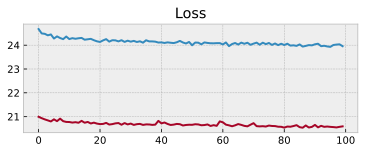

TEST mape: 20.59%


In [195]:
# Считываем лучшую модель
model4.load_weights('./data/best_model.hdf5')

# Уменьшаем шаг обучения до 0.001
optimizer = tf.keras.optimizers.Adam(0.001)
model4.compile(loss='MAPE', optimizer=optimizer, metrics=['MAPE'])

# Добавляем checkpoint
checkpoint = ModelCheckpoint(
    './data/best_model.hdf5', monitor=['val_MAPE'], verbose=0, mode='min')
earlystop = EarlyStopping(
    monitor='val_MAPE', patience=50, restore_best_weights=True,)
callbacks_list = [checkpoint, earlystop]


# Обучаем
history = model4.fit(X_train, y_train,
                     batch_size=512,
                     epochs=100,  # фактически мы обучаем пока EarlyStopping не остановит обучение
                     validation_data=(X_test, y_test),
                     callbacks=callbacks_list,
                     verbose=1,
                     )

plt.title('Loss')
plt.plot(history.history['MAPE'], label='train')
plt.plot(history.history['val_MAPE'], label='test')
plt.show()

model4.load_weights('./data/best_model.hdf5')
model4.save('./data/nn_1.hdf5')

test_predict_nn = model4.predict(X_test)
print(f"TEST mape: {(mape(y_test, test_predict_nn[:,0]))*100:0.2f}%")

С помощью простой полносвязной нейросети на 2х этапах (1й с шагом обучения 0.01, 2й с шагом обучения 0.001) мы достигли метрики MAPE 20.59% и не смогли улучшить результат RandomForestRegressor MAPE: 20.29%

## 13. Blending

In [196]:
blend_predict = (test_predict_catboost +
                 model2_test_predict + test_predict_nn[:, 0]) / 3
print(f"TEST mape: {(mape(y_test, blend_predict))*100:0.2f}%")

TEST mape: 18.68%


## Общие выводы
Что мы делали в проекте:
1) анализ и обработка датасета - 80% времени 
- определение признаков, создание новых категорий
- создание новых признаков на основе существующих
- анализ числовых признаков
- анализ категорийных признаков
- определение и удаление дубликатов записей
- определение и замена (удаление) пропусков
- определение и удаление выбросов

2) определение метрики качества (MAPE)

3) Создали несколько моделей для прогнозирования стоимости недвижимости:
- CatBoost
- RandomForestRegressor
- GradientBoostingRegressor
- Простая полносвязная нейросеть


Лучший одиночный результат MAPE: 20.29% был достигнут на модели RandomForestRegressor 

Далее по ухудшению метрики:
- 20.59% - простая полносвязная нейросеть
- 20.96% - CatBoost
- 24.97% - GradientBoostingRegressor

4) С помощью Blending существенно была увеличена метрика качества MAPE до 18.68%. Смешивались следующие модели:
- CatBoost
- RandomForestRegressor
- Простая полносвязная нейросеть

Что не удалось сделать: улучшить метрику качества моделей до 15%. Вероятно проблема во входном датасете и создании на его основе новых категорий. 

Для улучшения качества модели предлагается улучшить качество входных данных и дополнить их фотографиями недвижимости, сделать перебор гиперпараметров и признаков.